# Session (475165_f5_stage2_day2)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "475165_f5_stage2_day2" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "FALSE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "475165_f5"
day = "day2"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (35733, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


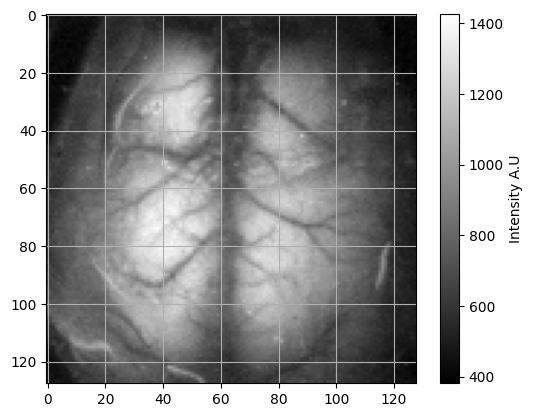

frame number 6000 plotted


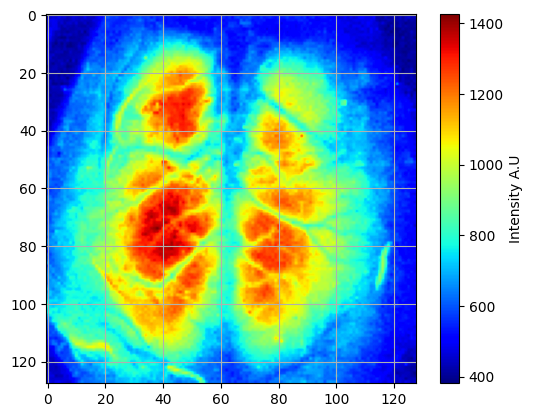

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 453.2398681640625 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 509.8948516845703


#### 4C: pybaselines (only run if missing flashes)

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

Number of double_flash: 94
Number of double_flash pairs: 47
Number of single_flash: 34
Number of total flashes: 128


## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:01<02:50,  1.34s/it]

  2%|█▎                                                                                | 2/128 [00:02<02:44,  1.31s/it]

  2%|█▉                                                                                | 3/128 [00:03<02:42,  1.30s/it]

  3%|██▌                                                                               | 4/128 [00:05<02:40,  1.29s/it]

  4%|███▏                                                                              | 5/128 [00:06<02:35,  1.26s/it]

  5%|███▊                                                                              | 6/128 [00:07<02:32,  1.25s/it]

  5%|████▍                                                                             | 7/128 [00:08<02:29,  1.23s/it]

  6%|█████▏                                                                            | 8/128 [00:10<02:34,  1.29s/it]

  7%|█████▊                                                                            | 9/128 [00:11<02:31,  1.27s/it]

  8%|██████▎                                                                          | 10/128 [00:12<02:30,  1.28s/it]

  9%|██████▉                                                                          | 11/128 [00:14<02:31,  1.29s/it]

  9%|███████▌                                                                         | 12/128 [00:15<02:30,  1.30s/it]

 10%|████████▏                                                                        | 13/128 [00:16<02:31,  1.32s/it]

 11%|████████▊                                                                        | 14/128 [00:18<02:27,  1.30s/it]

 12%|█████████▍                                                                       | 15/128 [00:19<02:24,  1.28s/it]

 12%|██████████▏                                                                      | 16/128 [00:20<02:23,  1.28s/it]

 13%|██████████▊                                                                      | 17/128 [00:21<02:24,  1.30s/it]

 14%|███████████▍                                                                     | 18/128 [00:23<02:27,  1.34s/it]

 15%|████████████                                                                     | 19/128 [00:24<02:26,  1.34s/it]

 16%|████████████▋                                                                    | 20/128 [00:26<02:25,  1.35s/it]

 16%|█████████████▎                                                                   | 21/128 [00:27<02:20,  1.32s/it]

 17%|█████████████▉                                                                   | 22/128 [00:28<02:17,  1.29s/it]

 18%|██████████████▌                                                                  | 23/128 [00:29<02:14,  1.28s/it]

 19%|███████████████▏                                                                 | 24/128 [00:30<02:10,  1.25s/it]

 20%|███████████████▊                                                                 | 25/128 [00:32<02:12,  1.29s/it]

 20%|████████████████▍                                                                | 26/128 [00:33<02:15,  1.33s/it]

 21%|█████████████████                                                                | 27/128 [00:35<02:12,  1.32s/it]

 22%|█████████████████▋                                                               | 28/128 [00:36<02:09,  1.29s/it]

 23%|██████████████████▎                                                              | 29/128 [00:37<02:08,  1.30s/it]

 23%|██████████████████▉                                                              | 30/128 [00:38<02:05,  1.28s/it]

 24%|███████████████████▌                                                             | 31/128 [00:40<02:05,  1.29s/it]

 25%|████████████████████▎                                                            | 32/128 [00:41<02:03,  1.28s/it]

 26%|████████████████████▉                                                            | 33/128 [00:42<02:01,  1.28s/it]

 27%|█████████████████████▌                                                           | 34/128 [00:43<02:00,  1.28s/it]

 27%|██████████████████████▏                                                          | 35/128 [00:45<01:57,  1.26s/it]

 28%|██████████████████████▊                                                          | 36/128 [00:46<01:59,  1.30s/it]

 29%|███████████████████████▍                                                         | 37/128 [00:47<01:58,  1.30s/it]

 30%|████████████████████████                                                         | 38/128 [00:49<01:56,  1.29s/it]

 30%|████████████████████████▋                                                        | 39/128 [00:50<01:56,  1.31s/it]

 31%|█████████████████████████▎                                                       | 40/128 [00:51<01:59,  1.36s/it]

 32%|█████████████████████████▉                                                       | 41/128 [00:53<01:54,  1.31s/it]

 33%|██████████████████████████▌                                                      | 42/128 [00:54<01:51,  1.30s/it]

 34%|███████████████████████████▏                                                     | 43/128 [00:55<01:46,  1.26s/it]

 34%|███████████████████████████▊                                                     | 44/128 [00:56<01:42,  1.22s/it]

 35%|████████████████████████████▍                                                    | 45/128 [00:58<01:43,  1.25s/it]

 36%|█████████████████████████████                                                    | 46/128 [00:59<01:43,  1.26s/it]

 37%|█████████████████████████████▋                                                   | 47/128 [01:00<01:44,  1.29s/it]

 38%|██████████████████████████████▍                                                  | 48/128 [01:01<01:41,  1.26s/it]

 38%|███████████████████████████████                                                  | 49/128 [01:03<01:39,  1.26s/it]

 39%|███████████████████████████████▋                                                 | 50/128 [01:04<01:40,  1.29s/it]

 40%|████████████████████████████████▎                                                | 51/128 [01:05<01:37,  1.26s/it]

 41%|████████████████████████████████▉                                                | 52/128 [01:06<01:35,  1.26s/it]

 41%|█████████████████████████████████▌                                               | 53/128 [01:08<01:37,  1.30s/it]

 42%|██████████████████████████████████▏                                              | 54/128 [01:09<01:37,  1.31s/it]

 43%|██████████████████████████████████▊                                              | 55/128 [01:10<01:34,  1.30s/it]

 44%|███████████████████████████████████▍                                             | 56/128 [01:12<01:31,  1.27s/it]

 45%|████████████████████████████████████                                             | 57/128 [01:13<01:30,  1.27s/it]

 45%|████████████████████████████████████▋                                            | 58/128 [01:14<01:30,  1.29s/it]

 46%|█████████████████████████████████████▎                                           | 59/128 [01:16<01:29,  1.30s/it]

 47%|█████████████████████████████████████▉                                           | 60/128 [01:17<01:30,  1.33s/it]

 48%|██████████████████████████████████████▌                                          | 61/128 [01:18<01:29,  1.34s/it]

 48%|███████████████████████████████████████▏                                         | 62/128 [01:20<01:25,  1.29s/it]

 49%|███████████████████████████████████████▊                                         | 63/128 [01:21<01:26,  1.33s/it]

 50%|████████████████████████████████████████▌                                        | 64/128 [01:22<01:23,  1.31s/it]

 51%|█████████████████████████████████████████▏                                       | 65/128 [01:24<01:23,  1.33s/it]

 52%|█████████████████████████████████████████▊                                       | 66/128 [01:25<01:21,  1.31s/it]

 52%|██████████████████████████████████████████▍                                      | 67/128 [01:26<01:18,  1.29s/it]

 53%|███████████████████████████████████████████                                      | 68/128 [01:27<01:19,  1.32s/it]

 54%|███████████████████████████████████████████▋                                     | 69/128 [01:29<01:18,  1.33s/it]

 55%|████████████████████████████████████████████▎                                    | 70/128 [01:30<01:16,  1.31s/it]

 55%|████████████████████████████████████████████▉                                    | 71/128 [01:31<01:13,  1.29s/it]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [01:33<01:12,  1.30s/it]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [01:34<01:11,  1.29s/it]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [01:35<01:10,  1.31s/it]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [01:37<01:12,  1.37s/it]

 59%|████████████████████████████████████████████████                                 | 76/128 [01:38<01:12,  1.39s/it]

 60%|████████████████████████████████████████████████▋                                | 77/128 [01:40<01:12,  1.41s/it]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [01:41<01:07,  1.36s/it]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [01:42<01:06,  1.35s/it]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [01:44<01:03,  1.32s/it]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [01:45<01:01,  1.31s/it]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [01:46<00:58,  1.26s/it]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [01:47<00:58,  1.30s/it]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [01:49<00:57,  1.30s/it]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [01:50<00:54,  1.27s/it]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [01:51<00:55,  1.32s/it]

 68%|███████████████████████████████████████████████████████                          | 87/128 [01:53<00:55,  1.34s/it]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [01:54<00:54,  1.35s/it]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [01:55<00:53,  1.37s/it]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [01:57<00:51,  1.36s/it]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [01:58<00:48,  1.32s/it]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [01:59<00:46,  1.30s/it]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [02:01<00:45,  1.29s/it]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [02:02<00:43,  1.29s/it]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [02:03<00:42,  1.28s/it]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [02:04<00:41,  1.29s/it]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [02:06<00:39,  1.26s/it]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [02:07<00:37,  1.25s/it]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [02:08<00:36,  1.27s/it]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [02:09<00:36,  1.29s/it]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [02:11<00:35,  1.30s/it]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [02:12<00:34,  1.33s/it]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [02:13<00:32,  1.30s/it]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [02:15<00:30,  1.28s/it]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [02:16<00:28,  1.26s/it]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [02:17<00:27,  1.25s/it]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [02:18<00:26,  1.25s/it]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [02:20<00:26,  1.30s/it]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [02:21<00:24,  1.29s/it]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [02:22<00:23,  1.32s/it]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [02:24<00:22,  1.33s/it]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [02:25<00:21,  1.34s/it]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [02:26<00:20,  1.34s/it]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [02:28<00:18,  1.32s/it]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [02:29<00:16,  1.27s/it]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [02:30<00:15,  1.29s/it]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [02:32<00:14,  1.30s/it]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [02:33<00:12,  1.29s/it]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [02:34<00:11,  1.32s/it]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [02:35<00:10,  1.31s/it]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [02:37<00:08,  1.29s/it]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [02:38<00:08,  1.34s/it]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [02:40<00:06,  1.35s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [02:41<00:05,  1.34s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [02:42<00:03,  1.32s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [02:43<00:02,  1.31s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [02:45<00:01,  1.32s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [02:46<00:00,  1.29s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [02:46<00:00,  1.30s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 23%|██████████████████▏                                                             | 29/128 [00:00<00:00, 287.22it/s]

 45%|████████████████████████████████████▎                                           | 58/128 [00:00<00:00, 259.97it/s]

 66%|█████████████████████████████████████████████████████▏                          | 85/128 [00:00<00:00, 213.06it/s]

 84%|██████████████████████████████████████████████████████████████████▋            | 108/128 [00:00<00:00, 215.84it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 220.76it/s]

  0%|                                                                                        | 0/34577 [00:00<?, ?it/s]

  0%|                                                                              | 24/34577 [00:00<02:26, 235.37it/s]

  0%|                                                                              | 48/34577 [00:00<02:30, 230.06it/s]

  0%|▏                                                                             | 72/34577 [00:00<02:42, 211.85it/s]

  0%|▏                                                                             | 94/34577 [00:00<02:49, 203.69it/s]

  0%|▎                                                                            | 118/34577 [00:00<02:41, 213.62it/s]

  0%|▎                                                                            | 143/34577 [00:00<02:34, 223.11it/s]

  0%|▍                                                                            | 170/34577 [00:00<02:25, 236.98it/s]

  1%|▍                                                                            | 196/34577 [00:00<02:22, 241.85it/s]

  1%|▍                                                                            | 223/34577 [00:00<02:17, 249.64it/s]

  1%|▌                                                                            | 249/34577 [00:01<02:24, 237.74it/s]

  1%|▌                                                                            | 276/34577 [00:01<02:18, 246.86it/s]

  1%|▋                                                                            | 302/34577 [00:01<02:19, 246.41it/s]

  1%|▋                                                                            | 327/34577 [00:01<02:21, 242.14it/s]

  1%|▊                                                                            | 352/34577 [00:01<02:24, 237.57it/s]

  1%|▊                                                                            | 379/34577 [00:01<02:18, 246.17it/s]

  1%|▉                                                                            | 406/34577 [00:01<02:17, 248.07it/s]

  1%|▉                                                                            | 434/34577 [00:01<02:13, 256.57it/s]

  1%|█                                                                            | 462/34577 [00:01<02:09, 262.66it/s]

  1%|█                                                                            | 489/34577 [00:02<02:15, 251.56it/s]

  1%|█▏                                                                           | 515/34577 [00:02<02:16, 249.02it/s]

  2%|█▏                                                                           | 541/34577 [00:02<02:22, 238.58it/s]

  2%|█▎                                                                           | 570/34577 [00:02<02:15, 250.81it/s]

  2%|█▎                                                                           | 599/34577 [00:02<02:10, 259.71it/s]

  2%|█▍                                                                           | 626/34577 [00:02<02:19, 242.57it/s]

  2%|█▍                                                                           | 651/34577 [00:02<02:24, 235.59it/s]

  2%|█▌                                                                           | 675/34577 [00:02<02:24, 234.26it/s]

  2%|█▌                                                                           | 699/34577 [00:02<02:24, 235.22it/s]

  2%|█▌                                                                           | 725/34577 [00:03<02:20, 240.92it/s]

  2%|█▋                                                                           | 750/34577 [00:03<02:23, 236.09it/s]

  2%|█▋                                                                           | 774/34577 [00:03<02:22, 236.55it/s]

  2%|█▊                                                                           | 802/34577 [00:03<02:16, 247.69it/s]

  2%|█▊                                                                           | 831/34577 [00:03<02:10, 257.77it/s]

  2%|█▉                                                                           | 860/34577 [00:03<02:07, 264.88it/s]

  3%|█▉                                                                           | 887/34577 [00:03<02:11, 256.65it/s]

  3%|██                                                                           | 913/34577 [00:03<02:15, 247.69it/s]

  3%|██                                                                           | 938/34577 [00:03<02:20, 240.22it/s]

  3%|██▏                                                                          | 963/34577 [00:03<02:21, 238.30it/s]

  3%|██▏                                                                          | 987/34577 [00:04<02:21, 236.80it/s]

  3%|██▏                                                                         | 1011/34577 [00:04<02:27, 227.97it/s]

  3%|██▎                                                                         | 1039/34577 [00:04<02:19, 240.44it/s]

  3%|██▎                                                                         | 1064/34577 [00:04<02:18, 241.42it/s]

  3%|██▍                                                                         | 1092/34577 [00:04<02:12, 251.82it/s]

  3%|██▍                                                                         | 1118/34577 [00:04<02:19, 239.34it/s]

  3%|██▌                                                                         | 1145/34577 [00:04<02:15, 245.91it/s]

  3%|██▌                                                                         | 1170/34577 [00:04<02:23, 233.15it/s]

  3%|██▋                                                                         | 1198/34577 [00:04<02:16, 244.14it/s]

  4%|██▋                                                                         | 1226/34577 [00:05<02:11, 253.57it/s]

  4%|██▊                                                                         | 1252/34577 [00:05<02:12, 251.12it/s]

  4%|██▊                                                                         | 1278/34577 [00:05<02:12, 252.24it/s]

  4%|██▊                                                                         | 1306/34577 [00:05<02:08, 258.81it/s]

  4%|██▉                                                                         | 1335/34577 [00:05<02:04, 266.38it/s]

  4%|██▉                                                                         | 1362/34577 [00:05<02:07, 261.34it/s]

  4%|███                                                                         | 1389/34577 [00:05<02:07, 259.37it/s]

  4%|███                                                                         | 1415/34577 [00:05<02:25, 228.49it/s]

  4%|███▏                                                                        | 1441/34577 [00:05<02:20, 235.04it/s]

  4%|███▏                                                                        | 1466/34577 [00:06<02:20, 235.29it/s]

  4%|███▎                                                                        | 1490/34577 [00:06<02:27, 224.15it/s]

  4%|███▎                                                                        | 1514/34577 [00:06<02:26, 226.03it/s]

  4%|███▍                                                                        | 1538/34577 [00:06<02:24, 229.31it/s]

  5%|███▍                                                                        | 1565/34577 [00:06<02:17, 239.54it/s]

  5%|███▍                                                                        | 1592/34577 [00:06<02:13, 246.20it/s]

  5%|███▌                                                                        | 1619/34577 [00:06<02:11, 250.22it/s]

  5%|███▌                                                                        | 1646/34577 [00:06<02:09, 255.25it/s]

  5%|███▋                                                                        | 1674/34577 [00:06<02:06, 259.48it/s]

  5%|███▋                                                                        | 1701/34577 [00:06<02:12, 248.76it/s]

  5%|███▊                                                                        | 1727/34577 [00:07<02:13, 246.39it/s]

  5%|███▊                                                                        | 1752/34577 [00:07<02:13, 246.13it/s]

  5%|███▉                                                                        | 1777/34577 [00:07<02:16, 239.69it/s]

  5%|███▉                                                                        | 1804/34577 [00:07<02:12, 247.91it/s]

  5%|████                                                                        | 1830/34577 [00:07<02:11, 249.82it/s]

  5%|████                                                                        | 1856/34577 [00:07<02:15, 241.82it/s]

  5%|████▏                                                                       | 1884/34577 [00:07<02:10, 249.83it/s]

  6%|████▏                                                                       | 1910/34577 [00:07<02:10, 250.51it/s]

  6%|████▎                                                                       | 1938/34577 [00:07<02:07, 255.31it/s]

  6%|████▎                                                                       | 1967/34577 [00:08<02:04, 262.31it/s]

  6%|████▍                                                                       | 1996/34577 [00:08<02:01, 267.27it/s]

  6%|████▍                                                                       | 2023/34577 [00:08<02:08, 252.68it/s]

  6%|████▌                                                                       | 2049/34577 [00:08<02:09, 250.53it/s]

  6%|████▌                                                                       | 2075/34577 [00:08<02:10, 248.32it/s]

  6%|████▌                                                                       | 2101/34577 [00:08<02:09, 250.95it/s]

  6%|████▋                                                                       | 2130/34577 [00:08<02:04, 259.98it/s]

  6%|████▋                                                                       | 2157/34577 [00:08<02:19, 231.99it/s]

  6%|████▊                                                                       | 2181/34577 [00:08<02:20, 231.06it/s]

  6%|████▊                                                                       | 2210/34577 [00:09<02:12, 244.55it/s]

  6%|████▉                                                                       | 2235/34577 [00:09<02:15, 238.12it/s]

  7%|████▉                                                                       | 2260/34577 [00:09<02:15, 238.79it/s]

  7%|█████                                                                       | 2288/34577 [00:09<02:10, 248.35it/s]

  7%|█████                                                                       | 2314/34577 [00:09<02:09, 248.86it/s]

  7%|█████▏                                                                      | 2342/34577 [00:09<02:06, 255.63it/s]

  7%|█████▏                                                                      | 2368/34577 [00:09<02:06, 253.98it/s]

  7%|█████▎                                                                      | 2394/34577 [00:09<02:09, 248.54it/s]

  7%|█████▎                                                                      | 2421/34577 [00:09<02:07, 251.84it/s]

  7%|█████▍                                                                      | 2450/34577 [00:09<02:02, 261.37it/s]

  7%|█████▍                                                                      | 2479/34577 [00:10<02:00, 266.62it/s]

  7%|█████▌                                                                      | 2506/34577 [00:10<01:59, 267.60it/s]

  7%|█████▌                                                                      | 2533/34577 [00:10<01:59, 267.12it/s]

  7%|█████▋                                                                      | 2560/34577 [00:10<02:01, 264.11it/s]

  7%|█████▋                                                                      | 2587/34577 [00:10<02:03, 259.02it/s]

  8%|█████▋                                                                      | 2613/34577 [00:10<02:05, 254.90it/s]

  8%|█████▊                                                                      | 2639/34577 [00:10<02:07, 250.60it/s]

  8%|█████▊                                                                      | 2665/34577 [00:10<02:06, 252.60it/s]

  8%|█████▉                                                                      | 2693/34577 [00:10<02:03, 258.34it/s]

  8%|█████▉                                                                      | 2719/34577 [00:11<02:03, 257.35it/s]

  8%|██████                                                                      | 2745/34577 [00:11<02:10, 243.41it/s]

  8%|██████                                                                      | 2773/34577 [00:11<02:06, 251.65it/s]

  8%|██████▏                                                                     | 2799/34577 [00:11<02:08, 247.13it/s]

  8%|██████▏                                                                     | 2828/34577 [00:11<02:03, 256.98it/s]

  8%|██████▎                                                                     | 2855/34577 [00:11<02:02, 258.51it/s]

  8%|██████▎                                                                     | 2883/34577 [00:11<02:00, 262.48it/s]

  8%|██████▍                                                                     | 2910/34577 [00:11<02:00, 262.73it/s]

  8%|██████▍                                                                     | 2938/34577 [00:11<01:59, 264.71it/s]

  9%|██████▌                                                                     | 2965/34577 [00:12<02:07, 248.85it/s]

  9%|██████▌                                                                     | 2991/34577 [00:12<02:08, 246.47it/s]

  9%|██████▋                                                                     | 3016/34577 [00:12<02:13, 235.56it/s]

  9%|██████▋                                                                     | 3045/34577 [00:12<02:06, 248.59it/s]

  9%|██████▊                                                                     | 3071/34577 [00:12<02:13, 236.50it/s]

  9%|██████▊                                                                     | 3097/34577 [00:12<02:09, 242.31it/s]

  9%|██████▊                                                                     | 3125/34577 [00:12<02:05, 250.81it/s]

  9%|██████▉                                                                     | 3152/34577 [00:12<02:03, 254.13it/s]

  9%|██████▉                                                                     | 3181/34577 [00:12<01:59, 262.20it/s]

  9%|███████                                                                     | 3210/34577 [00:12<01:57, 267.95it/s]

  9%|███████                                                                     | 3239/34577 [00:13<01:55, 272.01it/s]

  9%|███████▏                                                                    | 3268/34577 [00:13<01:53, 274.89it/s]

 10%|███████▏                                                                    | 3296/34577 [00:13<01:55, 270.09it/s]

 10%|███████▎                                                                    | 3324/34577 [00:13<01:55, 270.94it/s]

 10%|███████▎                                                                    | 3353/34577 [00:13<01:53, 274.12it/s]

 10%|███████▍                                                                    | 3381/34577 [00:13<01:56, 266.95it/s]

 10%|███████▍                                                                    | 3408/34577 [00:13<02:01, 256.77it/s]

 10%|███████▌                                                                    | 3435/34577 [00:13<01:59, 259.80it/s]

 10%|███████▌                                                                    | 3462/34577 [00:13<02:01, 256.14it/s]

 10%|███████▋                                                                    | 3491/34577 [00:14<01:57, 264.33it/s]

 10%|███████▋                                                                    | 3520/34577 [00:14<01:55, 269.43it/s]

 10%|███████▊                                                                    | 3549/34577 [00:14<01:53, 272.27it/s]

 10%|███████▊                                                                    | 3577/34577 [00:14<02:01, 254.57it/s]

 10%|███████▉                                                                    | 3603/34577 [00:14<02:05, 245.85it/s]

 11%|███████▉                                                                    | 3631/34577 [00:14<02:01, 253.90it/s]

 11%|████████                                                                    | 3657/34577 [00:14<02:01, 254.21it/s]

 11%|████████                                                                    | 3686/34577 [00:14<01:57, 262.22it/s]

 11%|████████▏                                                                   | 3713/34577 [00:14<02:06, 244.74it/s]

 11%|████████▏                                                                   | 3742/34577 [00:15<02:01, 254.44it/s]

 11%|████████▎                                                                   | 3768/34577 [00:15<02:05, 245.69it/s]

 11%|████████▎                                                                   | 3796/34577 [00:15<02:01, 253.14it/s]

 11%|████████▍                                                                   | 3822/34577 [00:15<02:01, 252.96it/s]

 11%|████████▍                                                                   | 3848/34577 [00:15<02:01, 252.83it/s]

 11%|████████▌                                                                   | 3874/34577 [00:15<02:02, 249.88it/s]

 11%|████████▌                                                                   | 3900/34577 [00:15<02:06, 242.36it/s]

 11%|████████▋                                                                   | 3925/34577 [00:15<02:13, 229.02it/s]

 11%|████████▋                                                                   | 3953/34577 [00:15<02:07, 241.04it/s]

 12%|████████▋                                                                   | 3978/34577 [00:16<02:11, 233.13it/s]

 12%|████████▊                                                                   | 4005/34577 [00:16<02:05, 242.69it/s]

 12%|████████▊                                                                   | 4031/34577 [00:16<02:05, 244.25it/s]

 12%|████████▉                                                                   | 4056/34577 [00:16<02:08, 238.44it/s]

 12%|████████▉                                                                   | 4080/34577 [00:16<02:18, 220.82it/s]

 12%|█████████                                                                   | 4106/34577 [00:16<02:12, 230.25it/s]

 12%|█████████                                                                   | 4131/34577 [00:16<02:11, 231.90it/s]

 12%|█████████▏                                                                  | 4158/34577 [00:16<02:06, 241.29it/s]

 12%|█████████▏                                                                  | 4183/34577 [00:16<02:09, 235.07it/s]

 12%|█████████▏                                                                  | 4207/34577 [00:16<02:11, 231.26it/s]

 12%|█████████▎                                                                  | 4235/34577 [00:17<02:04, 243.70it/s]

 12%|█████████▎                                                                  | 4263/34577 [00:17<02:00, 251.96it/s]

 12%|█████████▍                                                                  | 4291/34577 [00:17<01:57, 257.85it/s]

 12%|█████████▍                                                                  | 4317/34577 [00:17<01:58, 256.27it/s]

 13%|█████████▌                                                                  | 4343/34577 [00:17<02:06, 239.26it/s]

 13%|█████████▌                                                                  | 4368/34577 [00:17<02:06, 239.60it/s]

 13%|█████████▋                                                                  | 4393/34577 [00:17<02:11, 230.20it/s]

 13%|█████████▋                                                                  | 4420/34577 [00:17<02:05, 240.71it/s]

 13%|█████████▊                                                                  | 4449/34577 [00:17<01:59, 252.85it/s]

 13%|█████████▊                                                                  | 4478/34577 [00:18<01:55, 260.84it/s]

 13%|█████████▉                                                                  | 4506/34577 [00:18<01:53, 264.77it/s]

 13%|█████████▉                                                                  | 4533/34577 [00:18<02:03, 243.02it/s]

 13%|██████████                                                                  | 4558/34577 [00:18<02:08, 233.63it/s]

 13%|██████████                                                                  | 4586/34577 [00:18<02:02, 244.88it/s]

 13%|██████████▏                                                                 | 4613/34577 [00:18<01:59, 250.51it/s]

 13%|██████████▏                                                                 | 4639/34577 [00:18<02:02, 243.55it/s]

 13%|██████████▎                                                                 | 4664/34577 [00:18<02:05, 238.69it/s]

 14%|██████████▎                                                                 | 4692/34577 [00:18<02:00, 247.52it/s]

 14%|██████████▎                                                                 | 4720/34577 [00:19<01:57, 254.60it/s]

 14%|██████████▍                                                                 | 4746/34577 [00:19<02:00, 246.65it/s]

 14%|██████████▍                                                                 | 4771/34577 [00:19<02:06, 235.46it/s]

 14%|██████████▌                                                                 | 4795/34577 [00:19<02:06, 236.18it/s]

 14%|██████████▌                                                                 | 4819/34577 [00:19<02:12, 224.36it/s]

 14%|██████████▋                                                                 | 4842/34577 [00:19<02:16, 217.91it/s]

 14%|██████████▋                                                                 | 4864/34577 [00:19<02:20, 212.07it/s]

 14%|██████████▋                                                                 | 4890/34577 [00:19<02:13, 221.68it/s]

 14%|██████████▊                                                                 | 4917/34577 [00:19<02:06, 233.93it/s]

 14%|██████████▊                                                                 | 4941/34577 [00:20<02:06, 235.01it/s]

 14%|██████████▉                                                                 | 4969/34577 [00:20<02:00, 245.19it/s]

 14%|██████████▉                                                                 | 4997/34577 [00:20<01:56, 253.09it/s]

 15%|███████████                                                                 | 5026/34577 [00:20<01:53, 260.82it/s]

 15%|███████████                                                                 | 5053/34577 [00:20<01:55, 254.62it/s]

 15%|███████████▏                                                                | 5082/34577 [00:20<01:52, 261.79it/s]

 15%|███████████▏                                                                | 5109/34577 [00:20<01:56, 253.94it/s]

 15%|███████████▎                                                                | 5136/34577 [00:20<01:54, 257.06it/s]

 15%|███████████▎                                                                | 5162/34577 [00:20<01:56, 252.85it/s]

 15%|███████████▍                                                                | 5188/34577 [00:20<01:56, 251.32it/s]

 15%|███████████▍                                                                | 5214/34577 [00:21<01:57, 250.24it/s]

 15%|███████████▌                                                                | 5240/34577 [00:21<01:59, 245.30it/s]

 15%|███████████▌                                                                | 5265/34577 [00:21<02:10, 224.85it/s]

 15%|███████████▌                                                                | 5288/34577 [00:21<02:12, 220.88it/s]

 15%|███████████▋                                                                | 5311/34577 [00:21<02:13, 218.61it/s]

 15%|███████████▋                                                                | 5335/34577 [00:21<02:10, 223.94it/s]

 16%|███████████▊                                                                | 5364/34577 [00:21<02:01, 240.62it/s]

 16%|███████████▊                                                                | 5393/34577 [00:21<01:55, 252.61it/s]

 16%|███████████▉                                                                | 5422/34577 [00:21<01:51, 261.16it/s]

 16%|███████████▉                                                                | 5449/34577 [00:22<01:56, 250.67it/s]

 16%|████████████                                                                | 5475/34577 [00:22<02:00, 242.16it/s]

 16%|████████████                                                                | 5502/34577 [00:22<01:57, 248.45it/s]

 16%|████████████▏                                                               | 5530/34577 [00:22<01:53, 255.25it/s]

 16%|████████████▏                                                               | 5556/34577 [00:22<01:59, 242.18it/s]

 16%|████████████▎                                                               | 5585/34577 [00:22<01:54, 253.01it/s]

 16%|████████████▎                                                               | 5613/34577 [00:22<01:51, 259.20it/s]

 16%|████████████▍                                                               | 5640/34577 [00:22<01:54, 252.12it/s]

 16%|████████████▍                                                               | 5666/34577 [00:22<01:55, 249.93it/s]

 16%|████████████▌                                                               | 5693/34577 [00:23<01:53, 253.50it/s]

 17%|████████████▌                                                               | 5719/34577 [00:23<01:53, 254.66it/s]

 17%|████████████▋                                                               | 5745/34577 [00:23<01:53, 254.75it/s]

 17%|████████████▋                                                               | 5771/34577 [00:23<01:53, 254.08it/s]

 17%|████████████▋                                                               | 5799/34577 [00:23<01:50, 259.41it/s]

 17%|████████████▊                                                               | 5827/34577 [00:23<01:48, 263.92it/s]

 17%|████████████▊                                                               | 5855/34577 [00:23<01:47, 266.33it/s]

 17%|████████████▉                                                               | 5882/34577 [00:23<01:47, 266.65it/s]

 17%|████████████▉                                                               | 5910/34577 [00:23<01:46, 268.24it/s]

 17%|█████████████                                                               | 5938/34577 [00:23<01:46, 270.14it/s]

 17%|█████████████                                                               | 5966/34577 [00:24<01:45, 270.68it/s]

 17%|█████████████▏                                                              | 5995/34577 [00:24<01:44, 273.18it/s]

 17%|█████████████▏                                                              | 6023/34577 [00:24<01:49, 259.94it/s]

 18%|█████████████▎                                                              | 6051/34577 [00:24<01:47, 264.16it/s]

 18%|█████████████▎                                                              | 6078/34577 [00:24<01:47, 264.34it/s]

 18%|█████████████▍                                                              | 6106/34577 [00:24<01:46, 268.13it/s]

 18%|█████████████▍                                                              | 6133/34577 [00:24<01:49, 259.60it/s]

 18%|█████████████▌                                                              | 6162/34577 [00:24<01:46, 266.07it/s]

 18%|█████████████▌                                                              | 6189/34577 [00:24<01:50, 256.83it/s]

 18%|█████████████▋                                                              | 6216/34577 [00:25<01:49, 259.86it/s]

 18%|█████████████▋                                                              | 6245/34577 [00:25<01:46, 265.52it/s]

 18%|█████████████▊                                                              | 6273/34577 [00:25<01:45, 268.47it/s]

 18%|█████████████▊                                                              | 6300/34577 [00:25<01:45, 267.38it/s]

 18%|█████████████▉                                                              | 6327/34577 [00:25<01:47, 262.04it/s]

 18%|█████████████▉                                                              | 6354/34577 [00:25<01:48, 259.11it/s]

 18%|██████████████                                                              | 6382/34577 [00:25<01:47, 262.89it/s]

 19%|██████████████                                                              | 6409/34577 [00:25<01:48, 260.45it/s]

 19%|██████████████▏                                                             | 6438/34577 [00:25<01:45, 266.72it/s]

 19%|██████████████▏                                                             | 6466/34577 [00:25<01:44, 269.82it/s]

 19%|██████████████▎                                                             | 6494/34577 [00:26<01:43, 270.45it/s]

 19%|██████████████▎                                                             | 6522/34577 [00:26<01:43, 271.30it/s]

 19%|██████████████▍                                                             | 6551/34577 [00:26<01:41, 276.38it/s]

 19%|██████████████▍                                                             | 6579/34577 [00:26<01:43, 271.16it/s]

 19%|██████████████▌                                                             | 6607/34577 [00:26<01:45, 264.07it/s]

 19%|██████████████▌                                                             | 6636/34577 [00:26<01:43, 270.76it/s]

 19%|██████████████▋                                                             | 6665/34577 [00:26<01:41, 276.23it/s]

 19%|██████████████▋                                                             | 6693/34577 [00:26<01:44, 266.66it/s]

 19%|██████████████▊                                                             | 6721/34577 [00:26<01:43, 269.74it/s]

 20%|██████████████▊                                                             | 6749/34577 [00:27<01:46, 261.37it/s]

 20%|██████████████▉                                                             | 6779/34577 [00:27<01:42, 270.08it/s]

 20%|██████████████▉                                                             | 6809/34577 [00:27<01:40, 276.31it/s]

 20%|███████████████                                                             | 6837/34577 [00:27<01:47, 258.02it/s]

 20%|███████████████                                                             | 6864/34577 [00:27<01:48, 254.31it/s]

 20%|███████████████▏                                                            | 6891/34577 [00:27<01:47, 257.98it/s]

 20%|███████████████▏                                                            | 6918/34577 [00:27<01:47, 258.49it/s]

 20%|███████████████▎                                                            | 6944/34577 [00:27<01:51, 246.93it/s]

 20%|███████████████▎                                                            | 6972/34577 [00:27<01:48, 254.09it/s]

 20%|███████████████▍                                                            | 6998/34577 [00:28<01:54, 240.09it/s]

 20%|███████████████▍                                                            | 7023/34577 [00:28<01:56, 235.67it/s]

 20%|███████████████▍                                                            | 7047/34577 [00:28<01:56, 236.76it/s]

 20%|███████████████▌                                                            | 7071/34577 [00:28<01:57, 235.03it/s]

 21%|███████████████▌                                                            | 7096/34577 [00:28<01:56, 236.74it/s]

 21%|███████████████▋                                                            | 7122/34577 [00:28<01:53, 242.96it/s]

 21%|███████████████▋                                                            | 7150/34577 [00:28<01:48, 252.58it/s]

 21%|███████████████▊                                                            | 7179/34577 [00:28<01:44, 261.26it/s]

 21%|███████████████▊                                                            | 7206/34577 [00:28<01:47, 254.17it/s]

 21%|███████████████▉                                                            | 7232/34577 [00:28<01:53, 241.97it/s]

 21%|███████████████▉                                                            | 7258/34577 [00:29<01:50, 246.34it/s]

 21%|████████████████                                                            | 7284/34577 [00:29<01:50, 247.44it/s]

 21%|████████████████                                                            | 7311/34577 [00:29<01:48, 251.77it/s]

 21%|████████████████▏                                                           | 7337/34577 [00:29<01:48, 251.27it/s]

 21%|████████████████▏                                                           | 7364/34577 [00:29<01:47, 253.06it/s]

 21%|████████████████▏                                                           | 7390/34577 [00:29<01:55, 235.32it/s]

 21%|████████████████▎                                                           | 7414/34577 [00:29<01:58, 229.04it/s]

 22%|████████████████▎                                                           | 7442/34577 [00:29<01:52, 241.15it/s]

 22%|████████████████▍                                                           | 7468/34577 [00:29<01:50, 245.10it/s]

 22%|████████████████▍                                                           | 7493/34577 [00:30<01:51, 243.74it/s]

 22%|████████████████▌                                                           | 7518/34577 [00:30<01:53, 237.38it/s]

 22%|████████████████▌                                                           | 7545/34577 [00:30<01:49, 245.97it/s]

 22%|████████████████▋                                                           | 7571/34577 [00:30<01:48, 248.61it/s]

 22%|████████████████▋                                                           | 7596/34577 [00:30<01:54, 234.72it/s]

 22%|████████████████▊                                                           | 7621/34577 [00:30<01:54, 235.73it/s]

 22%|████████████████▊                                                           | 7647/34577 [00:30<01:51, 241.27it/s]

 22%|████████████████▊                                                           | 7672/34577 [00:30<01:51, 241.03it/s]

 22%|████████████████▉                                                           | 7699/34577 [00:30<01:48, 248.70it/s]

 22%|████████████████▉                                                           | 7724/34577 [00:30<01:51, 240.01it/s]

 22%|█████████████████                                                           | 7750/34577 [00:31<01:49, 244.36it/s]

 22%|█████████████████                                                           | 7775/34577 [00:31<01:56, 230.68it/s]

 23%|█████████████████▏                                                          | 7799/34577 [00:31<01:55, 232.01it/s]

 23%|█████████████████▏                                                          | 7828/34577 [00:31<01:48, 245.78it/s]

 23%|█████████████████▎                                                          | 7853/34577 [00:31<01:49, 244.81it/s]

 23%|█████████████████▎                                                          | 7878/34577 [00:31<01:54, 232.26it/s]

 23%|█████████████████▎                                                          | 7902/34577 [00:31<01:54, 233.15it/s]

 23%|█████████████████▍                                                          | 7930/34577 [00:31<01:49, 244.41it/s]

 23%|█████████████████▍                                                          | 7957/34577 [00:31<01:46, 250.35it/s]

 23%|█████████████████▌                                                          | 7983/34577 [00:32<01:45, 251.71it/s]

 23%|█████████████████▌                                                          | 8009/34577 [00:32<01:46, 249.07it/s]

 23%|█████████████████▋                                                          | 8034/34577 [00:32<01:47, 247.21it/s]

 23%|█████████████████▋                                                          | 8059/34577 [00:32<01:47, 245.90it/s]

 23%|█████████████████▊                                                          | 8084/34577 [00:32<01:48, 244.98it/s]

 23%|█████████████████▊                                                          | 8109/34577 [00:32<01:50, 239.47it/s]

 24%|█████████████████▉                                                          | 8138/34577 [00:32<01:44, 251.90it/s]

 24%|█████████████████▉                                                          | 8167/34577 [00:32<01:41, 261.47it/s]

 24%|██████████████████                                                          | 8195/34577 [00:32<01:39, 266.13it/s]

 24%|██████████████████                                                          | 8222/34577 [00:32<01:40, 261.91it/s]

 24%|██████████████████▏                                                         | 8250/34577 [00:33<01:39, 264.89it/s]

 24%|██████████████████▏                                                         | 8277/34577 [00:33<01:44, 252.40it/s]

 24%|██████████████████▎                                                         | 8306/34577 [00:33<01:40, 260.86it/s]

 24%|██████████████████▎                                                         | 8333/34577 [00:33<01:49, 240.75it/s]

 24%|██████████████████▍                                                         | 8360/34577 [00:33<01:45, 248.06it/s]

 24%|██████████████████▍                                                         | 8387/34577 [00:33<01:43, 252.10it/s]

 24%|██████████████████▍                                                         | 8414/34577 [00:33<01:43, 252.20it/s]

 24%|██████████████████▌                                                         | 8442/34577 [00:33<01:41, 258.66it/s]

 24%|██████████████████▌                                                         | 8469/34577 [00:33<01:43, 251.80it/s]

 25%|██████████████████▋                                                         | 8495/34577 [00:34<01:47, 242.48it/s]

 25%|██████████████████▋                                                         | 8523/34577 [00:34<01:43, 252.33it/s]

 25%|██████████████████▊                                                         | 8549/34577 [00:34<01:47, 241.14it/s]

 25%|██████████████████▊                                                         | 8575/34577 [00:34<01:46, 244.51it/s]

 25%|██████████████████▉                                                         | 8602/34577 [00:34<01:43, 250.06it/s]

 25%|██████████████████▉                                                         | 8631/34577 [00:34<01:40, 259.29it/s]

 25%|███████████████████                                                         | 8658/34577 [00:34<01:39, 259.41it/s]

 25%|███████████████████                                                         | 8685/34577 [00:34<01:45, 246.12it/s]

 25%|███████████████████▏                                                        | 8710/34577 [00:34<01:49, 235.39it/s]

 25%|███████████████████▏                                                        | 8737/34577 [00:35<01:45, 244.27it/s]

 25%|███████████████████▎                                                        | 8764/34577 [00:35<01:43, 248.74it/s]

 25%|███████████████████▎                                                        | 8791/34577 [00:35<01:41, 254.10it/s]

 26%|███████████████████▍                                                        | 8820/34577 [00:35<01:38, 262.21it/s]

 26%|███████████████████▍                                                        | 8847/34577 [00:35<01:51, 231.58it/s]

 26%|███████████████████▌                                                        | 8874/34577 [00:35<01:46, 241.19it/s]

 26%|███████████████████▌                                                        | 8899/34577 [00:35<01:45, 242.97it/s]

 26%|███████████████████▌                                                        | 8924/34577 [00:35<01:45, 244.28it/s]

 26%|███████████████████▋                                                        | 8949/34577 [00:35<01:46, 241.11it/s]

 26%|███████████████████▋                                                        | 8974/34577 [00:36<01:48, 236.90it/s]

 26%|███████████████████▊                                                        | 9003/34577 [00:36<01:42, 250.60it/s]

 26%|███████████████████▊                                                        | 9032/34577 [00:36<01:38, 260.47it/s]

 26%|███████████████████▉                                                        | 9061/34577 [00:36<01:35, 267.51it/s]

 26%|███████████████████▉                                                        | 9090/34577 [00:36<01:33, 273.31it/s]

 26%|████████████████████                                                        | 9120/34577 [00:36<01:30, 280.35it/s]

 26%|████████████████████                                                        | 9150/34577 [00:36<01:29, 284.50it/s]

 27%|████████████████████▏                                                       | 9180/34577 [00:36<01:29, 284.90it/s]

 27%|████████████████████▏                                                       | 9209/34577 [00:36<01:38, 256.32it/s]

 27%|████████████████████▎                                                       | 9236/34577 [00:37<01:44, 243.47it/s]

 27%|████████████████████▎                                                       | 9262/34577 [00:37<01:42, 246.59it/s]

 27%|████████████████████▍                                                       | 9291/34577 [00:37<01:38, 255.75it/s]

 27%|████████████████████▍                                                       | 9319/34577 [00:37<01:37, 259.66it/s]

 27%|████████████████████▌                                                       | 9346/34577 [00:37<01:40, 250.00it/s]

 27%|████████████████████▌                                                       | 9373/34577 [00:37<01:39, 253.09it/s]

 27%|████████████████████▋                                                       | 9403/34577 [00:37<01:34, 265.62it/s]

 27%|████████████████████▋                                                       | 9430/34577 [00:37<01:39, 251.59it/s]

 27%|████████████████████▊                                                       | 9457/34577 [00:37<01:38, 255.58it/s]

 27%|████████████████████▊                                                       | 9485/34577 [00:37<01:36, 260.32it/s]

 28%|████████████████████▉                                                       | 9513/34577 [00:38<01:35, 263.72it/s]

 28%|████████████████████▉                                                       | 9540/34577 [00:38<01:38, 254.53it/s]

 28%|█████████████████████                                                       | 9566/34577 [00:38<01:39, 251.83it/s]

 28%|█████████████████████                                                       | 9592/34577 [00:38<01:38, 253.46it/s]

 28%|█████████████████████▏                                                      | 9620/34577 [00:38<01:36, 258.90it/s]

 28%|█████████████████████▏                                                      | 9646/34577 [00:38<01:37, 255.54it/s]

 28%|█████████████████████▎                                                      | 9672/34577 [00:38<01:39, 249.62it/s]

 28%|█████████████████████▎                                                      | 9698/34577 [00:38<01:44, 238.26it/s]

 28%|█████████████████████▎                                                      | 9723/34577 [00:38<01:43, 240.22it/s]

 28%|█████████████████████▍                                                      | 9750/34577 [00:39<01:40, 246.59it/s]

 28%|█████████████████████▍                                                      | 9779/34577 [00:39<01:36, 256.86it/s]

 28%|█████████████████████▌                                                      | 9807/34577 [00:39<01:35, 259.08it/s]

 28%|█████████████████████▌                                                      | 9833/34577 [00:39<01:38, 250.69it/s]

 29%|█████████████████████▋                                                      | 9860/34577 [00:39<01:38, 251.91it/s]

 29%|█████████████████████▋                                                      | 9887/34577 [00:39<01:36, 254.92it/s]

 29%|█████████████████████▊                                                      | 9913/34577 [00:39<01:37, 252.77it/s]

 29%|█████████████████████▊                                                      | 9939/34577 [00:39<01:37, 251.97it/s]

 29%|█████████████████████▉                                                      | 9965/34577 [00:39<01:37, 252.86it/s]

 29%|█████████████████████▉                                                      | 9992/34577 [00:39<01:35, 256.38it/s]

 29%|█████████████████████▋                                                     | 10018/34577 [00:40<01:39, 245.95it/s]

 29%|█████████████████████▊                                                     | 10043/34577 [00:40<01:42, 238.30it/s]

 29%|█████████████████████▊                                                     | 10067/34577 [00:40<01:43, 237.46it/s]

 29%|█████████████████████▉                                                     | 10094/34577 [00:40<01:39, 245.40it/s]

 29%|█████████████████████▉                                                     | 10123/34577 [00:40<01:35, 256.10it/s]

 29%|██████████████████████                                                     | 10149/34577 [00:40<01:45, 231.68it/s]

 29%|██████████████████████                                                     | 10174/34577 [00:40<01:43, 236.05it/s]

 30%|██████████████████████▏                                                    | 10201/34577 [00:40<01:39, 244.87it/s]

 30%|██████████████████████▏                                                    | 10229/34577 [00:40<01:35, 254.17it/s]

 30%|██████████████████████▎                                                    | 10258/34577 [00:41<01:32, 261.52it/s]

 30%|██████████████████████▎                                                    | 10285/34577 [00:41<01:32, 261.90it/s]

 30%|██████████████████████▎                                                    | 10312/34577 [00:41<01:34, 255.65it/s]

 30%|██████████████████████▍                                                    | 10338/34577 [00:41<01:35, 254.03it/s]

 30%|██████████████████████▍                                                    | 10364/34577 [00:41<01:35, 253.19it/s]

 30%|██████████████████████▌                                                    | 10390/34577 [00:41<01:36, 250.83it/s]

 30%|██████████████████████▌                                                    | 10418/34577 [00:41<01:34, 256.91it/s]

 30%|██████████████████████▋                                                    | 10444/34577 [00:41<01:38, 244.21it/s]

 30%|██████████████████████▋                                                    | 10471/34577 [00:41<01:36, 250.80it/s]

 30%|██████████████████████▊                                                    | 10497/34577 [00:42<01:39, 242.35it/s]

 30%|██████████████████████▊                                                    | 10523/34577 [00:42<01:37, 245.96it/s]

 31%|██████████████████████▉                                                    | 10549/34577 [00:42<01:36, 247.87it/s]

 31%|██████████████████████▉                                                    | 10577/34577 [00:42<01:34, 254.22it/s]

 31%|███████████████████████                                                    | 10605/34577 [00:42<01:32, 259.45it/s]

 31%|███████████████████████                                                    | 10634/34577 [00:42<01:29, 266.80it/s]

 31%|███████████████████████                                                    | 10661/34577 [00:42<01:37, 244.22it/s]

 31%|███████████████████████▏                                                   | 10686/34577 [00:42<01:38, 241.84it/s]

 31%|███████████████████████▏                                                   | 10713/34577 [00:42<01:37, 244.94it/s]

 31%|███████████████████████▎                                                   | 10738/34577 [00:43<01:40, 238.34it/s]

 31%|███████████████████████▎                                                   | 10765/34577 [00:43<01:36, 245.85it/s]

 31%|███████████████████████▍                                                   | 10792/34577 [00:43<01:34, 252.49it/s]

 31%|███████████████████████▍                                                   | 10818/34577 [00:43<01:36, 246.84it/s]

 31%|███████████████████████▌                                                   | 10843/34577 [00:43<01:39, 237.61it/s]

 31%|███████████████████████▌                                                   | 10867/34577 [00:43<01:40, 235.58it/s]

 32%|███████████████████████▋                                                   | 10895/34577 [00:43<01:36, 246.14it/s]

 32%|███████████████████████▋                                                   | 10920/34577 [00:43<01:37, 241.72it/s]

 32%|███████████████████████▋                                                   | 10947/34577 [00:43<01:35, 247.71it/s]

 32%|███████████████████████▊                                                   | 10976/34577 [00:43<01:31, 257.71it/s]

 32%|███████████████████████▊                                                   | 11005/34577 [00:44<01:29, 264.80it/s]

 32%|███████████████████████▉                                                   | 11033/34577 [00:44<01:28, 266.15it/s]

 32%|███████████████████████▉                                                   | 11060/34577 [00:44<01:32, 255.39it/s]

 32%|████████████████████████                                                   | 11089/34577 [00:44<01:29, 263.02it/s]

 32%|████████████████████████                                                   | 11118/34577 [00:44<01:26, 270.02it/s]

 32%|████████████████████████▏                                                  | 11146/34577 [00:44<01:32, 253.10it/s]

 32%|████████████████████████▏                                                  | 11175/34577 [00:44<01:29, 260.49it/s]

 32%|████████████████████████▎                                                  | 11202/34577 [00:44<01:38, 236.53it/s]

 32%|████████████████████████▎                                                  | 11230/34577 [00:44<01:34, 246.14it/s]

 33%|████████████████████████▍                                                  | 11256/34577 [00:45<01:41, 230.42it/s]

 33%|████████████████████████▍                                                  | 11281/34577 [00:45<01:39, 234.38it/s]

 33%|████████████████████████▌                                                  | 11305/34577 [00:45<01:41, 229.66it/s]

 33%|████████████████████████▌                                                  | 11331/34577 [00:45<01:38, 235.45it/s]

 33%|████████████████████████▋                                                  | 11357/34577 [00:45<01:36, 240.33it/s]

 33%|████████████████████████▋                                                  | 11386/34577 [00:45<01:32, 251.61it/s]

 33%|████████████████████████▊                                                  | 11412/34577 [00:45<01:33, 246.97it/s]

 33%|████████████████████████▊                                                  | 11437/34577 [00:45<01:34, 243.69it/s]

 33%|████████████████████████▊                                                  | 11463/34577 [00:45<01:34, 245.57it/s]

 33%|████████████████████████▉                                                  | 11489/34577 [00:46<01:32, 248.31it/s]

 33%|████████████████████████▉                                                  | 11516/34577 [00:46<01:31, 252.43it/s]

 33%|█████████████████████████                                                  | 11542/34577 [00:46<01:32, 249.54it/s]

 33%|█████████████████████████                                                  | 11567/34577 [00:46<01:36, 238.64it/s]

 34%|█████████████████████████▏                                                 | 11591/34577 [00:46<01:39, 230.66it/s]

 34%|█████████████████████████▏                                                 | 11620/34577 [00:46<01:33, 245.35it/s]

 34%|█████████████████████████▎                                                 | 11646/34577 [00:46<01:32, 248.84it/s]

 34%|█████████████████████████▎                                                 | 11671/34577 [00:46<01:33, 244.96it/s]

 34%|█████████████████████████▍                                                 | 11699/34577 [00:46<01:30, 252.18it/s]

 34%|█████████████████████████▍                                                 | 11725/34577 [00:46<01:30, 252.28it/s]

 34%|█████████████████████████▍                                                 | 11753/34577 [00:47<01:28, 257.37it/s]

 34%|█████████████████████████▌                                                 | 11779/34577 [00:47<01:30, 252.29it/s]

 34%|█████████████████████████▌                                                 | 11805/34577 [00:47<01:34, 241.29it/s]

 34%|█████████████████████████▋                                                 | 11832/34577 [00:47<01:32, 246.62it/s]

 34%|█████████████████████████▋                                                 | 11860/34577 [00:47<01:29, 253.26it/s]

 34%|█████████████████████████▊                                                 | 11888/34577 [00:47<01:27, 257.99it/s]

 34%|█████████████████████████▊                                                 | 11914/34577 [00:47<01:35, 237.39it/s]

 35%|█████████████████████████▉                                                 | 11940/34577 [00:47<01:33, 241.63it/s]

 35%|█████████████████████████▉                                                 | 11968/34577 [00:47<01:29, 251.69it/s]

 35%|██████████████████████████                                                 | 11994/34577 [00:48<01:36, 232.84it/s]

 35%|██████████████████████████                                                 | 12018/34577 [00:48<01:38, 228.00it/s]

 35%|██████████████████████████                                                 | 12042/34577 [00:48<01:40, 223.95it/s]

 35%|██████████████████████████▏                                                | 12066/34577 [00:48<01:38, 227.75it/s]

 35%|██████████████████████████▏                                                | 12092/34577 [00:48<01:35, 235.52it/s]

 35%|██████████████████████████▎                                                | 12116/34577 [00:48<01:37, 230.89it/s]

 35%|██████████████████████████▎                                                | 12140/34577 [00:48<01:43, 216.28it/s]

 35%|██████████████████████████▍                                                | 12168/34577 [00:48<01:36, 231.20it/s]

 35%|██████████████████████████▍                                                | 12192/34577 [00:48<01:38, 227.34it/s]

 35%|██████████████████████████▍                                                | 12215/34577 [00:49<01:38, 226.84it/s]

 35%|██████████████████████████▌                                                | 12243/34577 [00:49<01:32, 241.28it/s]

 35%|██████████████████████████▌                                                | 12268/34577 [00:49<01:37, 229.30it/s]

 36%|██████████████████████████▋                                                | 12294/34577 [00:49<01:34, 236.88it/s]

 36%|██████████████████████████▋                                                | 12318/34577 [00:49<01:34, 236.45it/s]

 36%|██████████████████████████▊                                                | 12343/34577 [00:49<01:33, 238.65it/s]

 36%|██████████████████████████▊                                                | 12370/34577 [00:49<01:30, 245.63it/s]

 36%|██████████████████████████▉                                                | 12397/34577 [00:49<01:28, 251.28it/s]

 36%|██████████████████████████▉                                                | 12423/34577 [00:49<01:32, 238.51it/s]

 36%|███████████████████████████                                                | 12451/34577 [00:50<01:29, 248.13it/s]

 36%|███████████████████████████                                                | 12476/34577 [00:50<01:36, 229.08it/s]

 36%|███████████████████████████                                                | 12500/34577 [00:50<01:39, 222.37it/s]

 36%|███████████████████████████▏                                               | 12526/34577 [00:50<01:35, 232.00it/s]

 36%|███████████████████████████▏                                               | 12550/34577 [00:50<01:36, 227.89it/s]

 36%|███████████████████████████▎                                               | 12577/34577 [00:50<01:32, 238.36it/s]

 36%|███████████████████████████▎                                               | 12602/34577 [00:50<01:34, 233.08it/s]

 37%|███████████████████████████▍                                               | 12626/34577 [00:50<01:34, 232.43it/s]

 37%|███████████████████████████▍                                               | 12655/34577 [00:50<01:29, 246.03it/s]

 37%|███████████████████████████▌                                               | 12684/34577 [00:51<01:25, 256.46it/s]

 37%|███████████████████████████▌                                               | 12710/34577 [00:51<01:27, 250.98it/s]

 37%|███████████████████████████▋                                               | 12738/34577 [00:51<01:24, 258.59it/s]

 37%|███████████████████████████▋                                               | 12765/34577 [00:51<01:24, 259.67it/s]

 37%|███████████████████████████▋                                               | 12793/34577 [00:51<01:22, 264.84it/s]

 37%|███████████████████████████▊                                               | 12822/34577 [00:51<01:20, 269.09it/s]

 37%|███████████████████████████▊                                               | 12849/34577 [00:51<01:29, 243.70it/s]

 37%|███████████████████████████▉                                               | 12876/34577 [00:51<01:26, 249.57it/s]

 37%|███████████████████████████▉                                               | 12903/34577 [00:51<01:25, 254.62it/s]

 37%|████████████████████████████                                               | 12929/34577 [00:51<01:28, 245.66it/s]

 37%|████████████████████████████                                               | 12955/34577 [00:52<01:26, 249.01it/s]

 38%|████████████████████████████▏                                              | 12981/34577 [00:52<01:35, 226.87it/s]

 38%|████████████████████████████▏                                              | 13005/34577 [00:52<01:36, 224.09it/s]

 38%|████████████████████████████▎                                              | 13029/34577 [00:52<01:34, 227.31it/s]

 38%|████████████████████████████▎                                              | 13055/34577 [00:52<01:31, 236.08it/s]

 38%|████████████████████████████▍                                              | 13084/34577 [00:52<01:26, 249.32it/s]

 38%|████████████████████████████▍                                              | 13110/34577 [00:52<01:30, 237.92it/s]

 38%|████████████████████████████▍                                              | 13137/34577 [00:52<01:27, 246.20it/s]

 38%|████████████████████████████▌                                              | 13164/34577 [00:52<01:25, 250.25it/s]

 38%|████████████████████████████▌                                              | 13190/34577 [00:53<01:24, 251.63it/s]

 38%|████████████████████████████▋                                              | 13216/34577 [00:53<01:26, 246.93it/s]

 38%|████████████████████████████▋                                              | 13241/34577 [00:53<01:29, 239.59it/s]

 38%|████████████████████████████▊                                              | 13268/34577 [00:53<01:26, 247.54it/s]

 38%|████████████████████████████▊                                              | 13295/34577 [00:53<01:24, 252.57it/s]

 39%|████████████████████████████▉                                              | 13321/34577 [00:53<01:25, 249.68it/s]

 39%|████████████████████████████▉                                              | 13347/34577 [00:53<01:24, 251.24it/s]

 39%|█████████████████████████████                                              | 13376/34577 [00:53<01:21, 260.27it/s]

 39%|█████████████████████████████                                              | 13403/34577 [00:53<01:25, 247.26it/s]

 39%|█████████████████████████████▏                                             | 13431/34577 [00:54<01:23, 254.36it/s]

 39%|█████████████████████████████▏                                             | 13457/34577 [00:54<01:25, 247.52it/s]

 39%|█████████████████████████████▏                                             | 13482/34577 [00:54<01:25, 246.85it/s]

 39%|█████████████████████████████▎                                             | 13510/34577 [00:54<01:23, 253.47it/s]

 39%|█████████████████████████████▎                                             | 13536/34577 [00:54<01:23, 251.75it/s]

 39%|█████████████████████████████▍                                             | 13564/34577 [00:54<01:21, 259.18it/s]

 39%|█████████████████████████████▍                                             | 13592/34577 [00:54<01:19, 263.74it/s]

 39%|█████████████████████████████▌                                             | 13619/34577 [00:54<01:19, 264.82it/s]

 39%|█████████████████████████████▌                                             | 13646/34577 [00:54<01:23, 250.87it/s]

 40%|█████████████████████████████▋                                             | 13674/34577 [00:54<01:21, 256.97it/s]

 40%|█████████████████████████████▋                                             | 13700/34577 [00:55<01:21, 255.67it/s]

 40%|█████████████████████████████▊                                             | 13727/34577 [00:55<01:20, 258.34it/s]

 40%|█████████████████████████████▊                                             | 13753/34577 [00:55<01:27, 238.50it/s]

 40%|█████████████████████████████▉                                             | 13780/34577 [00:55<01:24, 246.56it/s]

 40%|█████████████████████████████▉                                             | 13807/34577 [00:55<01:22, 251.08it/s]

 40%|██████████████████████████████                                             | 13833/34577 [00:55<01:23, 247.29it/s]

 40%|██████████████████████████████                                             | 13860/34577 [00:55<01:21, 253.07it/s]

 40%|██████████████████████████████                                             | 13887/34577 [00:55<01:21, 255.04it/s]

 40%|██████████████████████████████▏                                            | 13913/34577 [00:55<01:21, 254.29it/s]

 40%|██████████████████████████████▏                                            | 13939/34577 [00:56<01:24, 245.27it/s]

 40%|██████████████████████████████▎                                            | 13966/34577 [00:56<01:22, 250.38it/s]

 40%|██████████████████████████████▎                                            | 13993/34577 [00:56<01:21, 253.86it/s]

 41%|██████████████████████████████▍                                            | 14021/34577 [00:56<01:19, 258.63it/s]

 41%|██████████████████████████████▍                                            | 14048/34577 [00:56<01:19, 259.43it/s]

 41%|██████████████████████████████▌                                            | 14074/34577 [00:56<01:22, 248.76it/s]

 41%|██████████████████████████████▌                                            | 14099/34577 [00:56<01:22, 248.98it/s]

 41%|██████████████████████████████▋                                            | 14124/34577 [00:56<01:23, 246.21it/s]

 41%|██████████████████████████████▋                                            | 14149/34577 [00:56<01:24, 240.37it/s]

 41%|██████████████████████████████▋                                            | 14175/34577 [00:57<01:23, 243.93it/s]

 41%|██████████████████████████████▊                                            | 14200/34577 [00:57<01:23, 244.29it/s]

 41%|██████████████████████████████▊                                            | 14226/34577 [00:57<01:22, 248.17it/s]

 41%|██████████████████████████████▉                                            | 14254/34577 [00:57<01:19, 254.54it/s]

 41%|██████████████████████████████▉                                            | 14280/34577 [00:57<01:21, 250.30it/s]

 41%|███████████████████████████████                                            | 14307/34577 [00:57<01:19, 253.83it/s]

 41%|███████████████████████████████                                            | 14333/34577 [00:57<01:25, 237.66it/s]

 42%|███████████████████████████████▏                                           | 14360/34577 [00:57<01:22, 245.34it/s]

 42%|███████████████████████████████▏                                           | 14387/34577 [00:57<01:21, 248.83it/s]

 42%|███████████████████████████████▎                                           | 14413/34577 [00:57<01:21, 247.80it/s]

 42%|███████████████████████████████▎                                           | 14438/34577 [00:58<01:23, 241.54it/s]

 42%|███████████████████████████████▎                                           | 14463/34577 [00:58<01:29, 224.20it/s]

 42%|███████████████████████████████▍                                           | 14486/34577 [00:58<01:32, 218.17it/s]

 42%|███████████████████████████████▍                                           | 14512/34577 [00:58<01:28, 227.91it/s]

 42%|███████████████████████████████▌                                           | 14538/34577 [00:58<01:25, 234.92it/s]

 42%|███████████████████████████████▌                                           | 14563/34577 [00:58<01:23, 238.50it/s]

 42%|███████████████████████████████▋                                           | 14591/34577 [00:58<01:20, 247.61it/s]

 42%|███████████████████████████████▋                                           | 14616/34577 [00:58<01:21, 244.79it/s]

 42%|███████████████████████████████▊                                           | 14641/34577 [00:58<01:23, 239.40it/s]

 42%|███████████████████████████████▊                                           | 14666/34577 [00:59<01:24, 234.40it/s]

 42%|███████████████████████████████▊                                           | 14690/34577 [00:59<01:27, 226.39it/s]

 43%|███████████████████████████████▉                                           | 14715/34577 [00:59<01:25, 230.99it/s]

 43%|███████████████████████████████▉                                           | 14744/34577 [00:59<01:20, 245.76it/s]

 43%|████████████████████████████████                                           | 14769/34577 [00:59<01:21, 242.14it/s]

 43%|████████████████████████████████                                           | 14795/34577 [00:59<01:20, 245.18it/s]

 43%|████████████████████████████████▏                                          | 14820/34577 [00:59<01:25, 231.87it/s]

 43%|████████████████████████████████▏                                          | 14847/34577 [00:59<01:21, 241.87it/s]

 43%|████████████████████████████████▎                                          | 14874/34577 [00:59<01:19, 247.79it/s]

 43%|████████████████████████████████▎                                          | 14900/34577 [01:00<01:18, 249.89it/s]

 43%|████████████████████████████████▍                                          | 14926/34577 [01:00<01:24, 233.24it/s]

 43%|████████████████████████████████▍                                          | 14950/34577 [01:00<01:26, 226.97it/s]

 43%|████████████████████████████████▍                                          | 14976/34577 [01:00<01:23, 235.46it/s]

 43%|████████████████████████████████▌                                          | 15003/34577 [01:00<01:20, 244.54it/s]

 43%|████████████████████████████████▌                                          | 15030/34577 [01:00<01:18, 250.43it/s]

 44%|████████████████████████████████▋                                          | 15056/34577 [01:00<01:19, 246.10it/s]

 44%|████████████████████████████████▋                                          | 15081/34577 [01:00<01:21, 239.02it/s]

 44%|████████████████████████████████▊                                          | 15108/34577 [01:00<01:19, 245.74it/s]

 44%|████████████████████████████████▊                                          | 15133/34577 [01:00<01:23, 232.97it/s]

 44%|████████████████████████████████▉                                          | 15157/34577 [01:01<01:24, 231.08it/s]

 44%|████████████████████████████████▉                                          | 15186/34577 [01:01<01:18, 245.61it/s]

 44%|█████████████████████████████████                                          | 15215/34577 [01:01<01:15, 255.91it/s]

 44%|█████████████████████████████████                                          | 15244/34577 [01:01<01:13, 262.79it/s]

 44%|█████████████████████████████████                                          | 15271/34577 [01:01<01:17, 250.70it/s]

 44%|█████████████████████████████████▏                                         | 15299/34577 [01:01<01:14, 257.73it/s]

 44%|█████████████████████████████████▏                                         | 15325/34577 [01:01<01:18, 245.11it/s]

 44%|█████████████████████████████████▎                                         | 15350/34577 [01:01<01:22, 232.25it/s]

 44%|█████████████████████████████████▎                                         | 15377/34577 [01:01<01:19, 241.92it/s]

 45%|█████████████████████████████████▍                                         | 15404/34577 [01:02<01:17, 248.41it/s]

 45%|█████████████████████████████████▍                                         | 15431/34577 [01:02<01:15, 253.86it/s]

 45%|█████████████████████████████████▌                                         | 15457/34577 [01:02<01:16, 249.89it/s]

 45%|█████████████████████████████████▌                                         | 15484/34577 [01:02<01:15, 253.51it/s]

 45%|█████████████████████████████████▋                                         | 15511/34577 [01:02<01:14, 257.56it/s]

 45%|█████████████████████████████████▋                                         | 15538/34577 [01:02<01:13, 260.45it/s]

 45%|█████████████████████████████████▊                                         | 15565/34577 [01:02<01:13, 260.23it/s]

 45%|█████████████████████████████████▊                                         | 15592/34577 [01:02<01:19, 237.38it/s]

 45%|█████████████████████████████████▊                                         | 15617/34577 [01:02<01:22, 229.54it/s]

 45%|█████████████████████████████████▉                                         | 15644/34577 [01:03<01:19, 238.61it/s]

 45%|█████████████████████████████████▉                                         | 15669/34577 [01:03<01:18, 241.13it/s]

 45%|██████████████████████████████████                                         | 15697/34577 [01:03<01:15, 250.06it/s]

 45%|██████████████████████████████████                                         | 15723/34577 [01:03<01:14, 252.21it/s]

 46%|██████████████████████████████████▏                                        | 15749/34577 [01:03<01:16, 245.25it/s]

 46%|██████████████████████████████████▏                                        | 15776/34577 [01:03<01:15, 249.49it/s]

 46%|██████████████████████████████████▎                                        | 15802/34577 [01:03<01:15, 249.66it/s]

 46%|██████████████████████████████████▎                                        | 15828/34577 [01:03<01:15, 249.79it/s]

 46%|██████████████████████████████████▍                                        | 15854/34577 [01:03<01:15, 248.45it/s]

 46%|██████████████████████████████████▍                                        | 15883/34577 [01:03<01:12, 258.25it/s]

 46%|██████████████████████████████████▌                                        | 15909/34577 [01:04<01:15, 247.98it/s]

 46%|██████████████████████████████████▌                                        | 15934/34577 [01:04<01:19, 235.20it/s]

 46%|██████████████████████████████████▌                                        | 15958/34577 [01:04<01:18, 235.90it/s]

 46%|██████████████████████████████████▋                                        | 15986/34577 [01:04<01:14, 247.97it/s]

 46%|██████████████████████████████████▋                                        | 16012/34577 [01:04<01:14, 249.36it/s]

 46%|██████████████████████████████████▊                                        | 16038/34577 [01:04<01:15, 246.75it/s]

 46%|██████████████████████████████████▊                                        | 16067/34577 [01:04<01:12, 257.01it/s]

 47%|██████████████████████████████████▉                                        | 16095/34577 [01:04<01:10, 262.94it/s]

 47%|██████████████████████████████████▉                                        | 16123/34577 [01:04<01:09, 266.39it/s]

 47%|███████████████████████████████████                                        | 16150/34577 [01:05<01:10, 261.35it/s]

 47%|███████████████████████████████████                                        | 16179/34577 [01:05<01:08, 267.37it/s]

 47%|███████████████████████████████████▏                                       | 16207/34577 [01:05<01:08, 269.50it/s]

 47%|███████████████████████████████████▏                                       | 16236/34577 [01:05<01:07, 273.13it/s]

 47%|███████████████████████████████████▎                                       | 16264/34577 [01:05<01:08, 268.87it/s]

 47%|███████████████████████████████████▎                                       | 16291/34577 [01:05<01:08, 267.67it/s]

 47%|███████████████████████████████████▍                                       | 16318/34577 [01:05<01:09, 263.75it/s]

 47%|███████████████████████████████████▍                                       | 16345/34577 [01:05<01:13, 246.93it/s]

 47%|███████████████████████████████████▌                                       | 16374/34577 [01:05<01:10, 256.81it/s]

 47%|███████████████████████████████████▌                                       | 16403/34577 [01:06<01:08, 263.99it/s]

 48%|███████████████████████████████████▋                                       | 16430/34577 [01:06<01:13, 245.37it/s]

 48%|███████████████████████████████████▋                                       | 16455/34577 [01:06<01:17, 233.24it/s]

 48%|███████████████████████████████████▋                                       | 16479/34577 [01:06<01:17, 233.20it/s]

 48%|███████████████████████████████████▊                                       | 16504/34577 [01:06<01:16, 237.22it/s]

 48%|███████████████████████████████████▊                                       | 16532/34577 [01:06<01:12, 247.25it/s]

 48%|███████████████████████████████████▉                                       | 16560/34577 [01:06<01:10, 255.18it/s]

 48%|███████████████████████████████████▉                                       | 16586/34577 [01:06<01:13, 245.26it/s]

 48%|████████████████████████████████████                                       | 16611/34577 [01:06<01:15, 237.88it/s]

 48%|████████████████████████████████████                                       | 16640/34577 [01:07<01:11, 250.42it/s]

 48%|████████████████████████████████████▏                                      | 16666/34577 [01:07<01:11, 251.02it/s]

 48%|████████████████████████████████████▏                                      | 16692/34577 [01:07<01:13, 244.50it/s]

 48%|████████████████████████████████████▎                                      | 16717/34577 [01:07<01:13, 242.21it/s]

 48%|████████████████████████████████████▎                                      | 16742/34577 [01:07<01:14, 238.93it/s]

 48%|████████████████████████████████████▎                                      | 16767/34577 [01:07<01:14, 240.23it/s]

 49%|████████████████████████████████████▍                                      | 16792/34577 [01:07<01:20, 220.27it/s]

 49%|████████████████████████████████████▍                                      | 16820/34577 [01:07<01:15, 235.99it/s]

 49%|████████████████████████████████████▌                                      | 16844/34577 [01:07<01:14, 236.55it/s]

 49%|████████████████████████████████████▌                                      | 16868/34577 [01:07<01:18, 226.94it/s]

 49%|████████████████████████████████████▋                                      | 16894/34577 [01:08<01:15, 235.55it/s]

 49%|████████████████████████████████████▋                                      | 16919/34577 [01:08<01:14, 238.33it/s]

 49%|████████████████████████████████████▊                                      | 16945/34577 [01:08<01:12, 243.90it/s]

 49%|████████████████████████████████████▊                                      | 16971/34577 [01:08<01:11, 247.89it/s]

 49%|████████████████████████████████████▊                                      | 16996/34577 [01:08<01:13, 239.41it/s]

 49%|████████████████████████████████████▉                                      | 17023/34577 [01:08<01:11, 246.81it/s]

 49%|████████████████████████████████████▉                                      | 17048/34577 [01:08<01:12, 241.46it/s]

 49%|█████████████████████████████████████                                      | 17076/34577 [01:08<01:09, 251.12it/s]

 49%|█████████████████████████████████████                                      | 17102/34577 [01:08<01:11, 245.19it/s]

 50%|█████████████████████████████████████▏                                     | 17128/34577 [01:09<01:10, 248.03it/s]

 50%|█████████████████████████████████████▏                                     | 17154/34577 [01:09<01:09, 249.35it/s]

 50%|█████████████████████████████████████▎                                     | 17182/34577 [01:09<01:08, 255.31it/s]

 50%|█████████████████████████████████████▎                                     | 17208/34577 [01:09<01:09, 251.58it/s]

 50%|█████████████████████████████████████▍                                     | 17235/34577 [01:09<01:08, 254.00it/s]

 50%|█████████████████████████████████████▍                                     | 17262/34577 [01:09<01:07, 257.92it/s]

 50%|█████████████████████████████████████▌                                     | 17289/34577 [01:09<01:06, 259.95it/s]

 50%|█████████████████████████████████████▌                                     | 17316/34577 [01:09<01:06, 257.64it/s]

 50%|█████████████████████████████████████▌                                     | 17342/34577 [01:09<01:11, 240.82it/s]

 50%|█████████████████████████████████████▋                                     | 17367/34577 [01:10<01:14, 231.75it/s]

 50%|█████████████████████████████████████▋                                     | 17391/34577 [01:10<01:15, 227.77it/s]

 50%|█████████████████████████████████████▊                                     | 17418/34577 [01:10<01:12, 236.87it/s]

 50%|█████████████████████████████████████▊                                     | 17442/34577 [01:10<01:14, 229.99it/s]

 51%|█████████████████████████████████████▉                                     | 17469/34577 [01:10<01:11, 240.54it/s]

 51%|█████████████████████████████████████▉                                     | 17496/34577 [01:10<01:09, 247.55it/s]

 51%|██████████████████████████████████████                                     | 17523/34577 [01:10<01:07, 253.32it/s]

 51%|██████████████████████████████████████                                     | 17549/34577 [01:10<01:10, 241.24it/s]

 51%|██████████████████████████████████████                                     | 17576/34577 [01:10<01:08, 247.29it/s]

 51%|██████████████████████████████████████▏                                    | 17603/34577 [01:10<01:07, 251.64it/s]

 51%|██████████████████████████████████████▏                                    | 17631/34577 [01:11<01:05, 259.09it/s]

 51%|██████████████████████████████████████▎                                    | 17658/34577 [01:11<01:04, 262.11it/s]

 51%|██████████████████████████████████████▎                                    | 17685/34577 [01:11<01:04, 263.68it/s]

 51%|██████████████████████████████████████▍                                    | 17714/34577 [01:11<01:02, 269.39it/s]

 51%|██████████████████████████████████████▍                                    | 17741/34577 [01:11<01:05, 258.43it/s]

 51%|██████████████████████████████████████▌                                    | 17767/34577 [01:11<01:05, 256.69it/s]

 51%|██████████████████████████████████████▌                                    | 17793/34577 [01:11<01:09, 243.17it/s]

 52%|██████████████████████████████████████▋                                    | 17818/34577 [01:11<01:08, 242.89it/s]

 52%|██████████████████████████████████████▋                                    | 17846/34577 [01:11<01:06, 250.62it/s]

 52%|██████████████████████████████████████▊                                    | 17872/34577 [01:12<01:08, 242.89it/s]

 52%|██████████████████████████████████████▊                                    | 17899/34577 [01:12<01:06, 249.15it/s]

 52%|██████████████████████████████████████▉                                    | 17926/34577 [01:12<01:05, 254.41it/s]

 52%|██████████████████████████████████████▉                                    | 17952/34577 [01:12<01:05, 252.40it/s]

 52%|██████████████████████████████████████▉                                    | 17979/34577 [01:12<01:05, 255.31it/s]

 52%|███████████████████████████████████████                                    | 18006/34577 [01:12<01:04, 258.85it/s]

 52%|███████████████████████████████████████                                    | 18032/34577 [01:12<01:04, 256.21it/s]

 52%|███████████████████████████████████████▏                                   | 18058/34577 [01:12<01:05, 253.63it/s]

 52%|███████████████████████████████████████▏                                   | 18085/34577 [01:12<01:04, 256.19it/s]

 52%|███████████████████████████████████████▎                                   | 18111/34577 [01:12<01:07, 244.47it/s]

 52%|███████████████████████████████████████▎                                   | 18136/34577 [01:13<01:08, 239.26it/s]

 53%|███████████████████████████████████████▍                                   | 18161/34577 [01:13<01:08, 238.28it/s]

 53%|███████████████████████████████████████▍                                   | 18186/34577 [01:13<01:08, 238.92it/s]

 53%|███████████████████████████████████████▌                                   | 18214/34577 [01:13<01:05, 249.81it/s]

 53%|███████████████████████████████████████▌                                   | 18240/34577 [01:13<01:05, 249.90it/s]

 53%|███████████████████████████████████████▌                                   | 18267/34577 [01:13<01:04, 254.32it/s]

 53%|███████████████████████████████████████▋                                   | 18294/34577 [01:13<01:03, 256.68it/s]

 53%|███████████████████████████████████████▋                                   | 18321/34577 [01:13<01:02, 259.84it/s]

 53%|███████████████████████████████████████▊                                   | 18348/34577 [01:13<01:02, 259.05it/s]

 53%|███████████████████████████████████████▊                                   | 18374/34577 [01:14<01:03, 256.35it/s]

 53%|███████████████████████████████████████▉                                   | 18402/34577 [01:14<01:01, 261.76it/s]

 53%|███████████████████████████████████████▉                                   | 18429/34577 [01:14<01:07, 238.32it/s]

 53%|████████████████████████████████████████                                   | 18454/34577 [01:14<01:06, 240.89it/s]

 53%|████████████████████████████████████████                                   | 18479/34577 [01:14<01:07, 238.12it/s]

 54%|████████████████████████████████████████▏                                  | 18504/34577 [01:14<01:09, 230.45it/s]

 54%|████████████████████████████████████████▏                                  | 18532/34577 [01:14<01:06, 242.21it/s]

 54%|████████████████████████████████████████▎                                  | 18559/34577 [01:14<01:04, 247.98it/s]

 54%|████████████████████████████████████████▎                                  | 18584/34577 [01:14<01:04, 247.87it/s]

 54%|████████████████████████████████████████▎                                  | 18610/34577 [01:14<01:03, 249.96it/s]

 54%|████████████████████████████████████████▍                                  | 18636/34577 [01:15<01:06, 239.65it/s]

 54%|████████████████████████████████████████▍                                  | 18663/34577 [01:15<01:04, 245.48it/s]

 54%|████████████████████████████████████████▌                                  | 18688/34577 [01:15<01:07, 234.73it/s]

 54%|████████████████████████████████████████▌                                  | 18715/34577 [01:15<01:05, 243.25it/s]

 54%|████████████████████████████████████████▋                                  | 18742/34577 [01:15<01:03, 250.17it/s]

 54%|████████████████████████████████████████▋                                  | 18771/34577 [01:15<01:01, 258.69it/s]

 54%|████████████████████████████████████████▊                                  | 18797/34577 [01:15<01:01, 255.40it/s]

 54%|████████████████████████████████████████▊                                  | 18825/34577 [01:15<01:00, 259.54it/s]

 55%|████████████████████████████████████████▉                                  | 18854/34577 [01:15<00:59, 266.09it/s]

 55%|████████████████████████████████████████▉                                  | 18883/34577 [01:16<00:57, 270.72it/s]

 55%|█████████████████████████████████████████                                  | 18912/34577 [01:16<00:57, 273.98it/s]

 55%|█████████████████████████████████████████                                  | 18941/34577 [01:16<00:56, 277.07it/s]

 55%|█████████████████████████████████████████▏                                 | 18969/34577 [01:16<00:57, 270.73it/s]

 55%|█████████████████████████████████████████▏                                 | 18997/34577 [01:16<00:58, 264.43it/s]

 55%|█████████████████████████████████████████▎                                 | 19024/34577 [01:16<00:58, 265.73it/s]

 55%|█████████████████████████████████████████▎                                 | 19052/34577 [01:16<00:58, 266.80it/s]

 55%|█████████████████████████████████████████▍                                 | 19079/34577 [01:16<01:00, 258.01it/s]

 55%|█████████████████████████████████████████▍                                 | 19106/34577 [01:16<00:59, 260.72it/s]

 55%|█████████████████████████████████████████▌                                 | 19133/34577 [01:16<00:58, 261.91it/s]

 55%|█████████████████████████████████████████▌                                 | 19160/34577 [01:17<00:59, 259.01it/s]

 55%|█████████████████████████████████████████▌                                 | 19186/34577 [01:17<00:59, 258.58it/s]

 56%|█████████████████████████████████████████▋                                 | 19213/34577 [01:17<00:58, 260.42it/s]

 56%|█████████████████████████████████████████▋                                 | 19240/34577 [01:17<00:58, 261.72it/s]

 56%|█████████████████████████████████████████▊                                 | 19267/34577 [01:17<00:58, 263.41it/s]

 56%|█████████████████████████████████████████▊                                 | 19294/34577 [01:17<00:58, 262.28it/s]

 56%|█████████████████████████████████████████▉                                 | 19322/34577 [01:17<00:57, 265.18it/s]

 56%|█████████████████████████████████████████▉                                 | 19349/34577 [01:17<00:58, 258.27it/s]

 56%|██████████████████████████████████████████                                 | 19376/34577 [01:17<00:58, 260.18it/s]

 56%|██████████████████████████████████████████                                 | 19403/34577 [01:18<00:58, 257.81it/s]

 56%|██████████████████████████████████████████▏                                | 19429/34577 [01:18<01:00, 250.49it/s]

 56%|██████████████████████████████████████████▏                                | 19457/34577 [01:18<00:58, 256.38it/s]

 56%|██████████████████████████████████████████▎                                | 19485/34577 [01:18<00:57, 263.02it/s]

 56%|██████████████████████████████████████████▎                                | 19513/34577 [01:18<00:56, 265.67it/s]

 57%|██████████████████████████████████████████▍                                | 19540/34577 [01:18<00:58, 255.75it/s]

 57%|██████████████████████████████████████████▍                                | 19566/34577 [01:18<01:00, 247.11it/s]

 57%|██████████████████████████████████████████▍                                | 19593/34577 [01:18<00:59, 252.16it/s]

 57%|██████████████████████████████████████████▌                                | 19619/34577 [01:18<00:59, 251.55it/s]

 57%|██████████████████████████████████████████▌                                | 19645/34577 [01:19<01:02, 238.25it/s]

 57%|██████████████████████████████████████████▋                                | 19673/34577 [01:19<01:00, 247.14it/s]

 57%|██████████████████████████████████████████▋                                | 19701/34577 [01:19<00:58, 254.28it/s]

 57%|██████████████████████████████████████████▊                                | 19728/34577 [01:19<00:57, 256.60it/s]

 57%|██████████████████████████████████████████▊                                | 19754/34577 [01:19<00:58, 254.88it/s]

 57%|██████████████████████████████████████████▉                                | 19780/34577 [01:19<00:59, 250.59it/s]

 57%|██████████████████████████████████████████▉                                | 19808/34577 [01:19<00:57, 258.33it/s]

 57%|███████████████████████████████████████████                                | 19835/34577 [01:19<00:56, 258.74it/s]

 57%|███████████████████████████████████████████                                | 19863/34577 [01:19<00:56, 262.66it/s]

 58%|███████████████████████████████████████████▏                               | 19890/34577 [01:19<01:00, 242.86it/s]

 58%|███████████████████████████████████████████▏                               | 19919/34577 [01:20<00:57, 253.12it/s]

 58%|███████████████████████████████████████████▎                               | 19945/34577 [01:20<00:58, 250.85it/s]

 58%|███████████████████████████████████████████▎                               | 19971/34577 [01:20<00:58, 249.23it/s]

 58%|███████████████████████████████████████████▎                               | 19997/34577 [01:20<01:00, 240.03it/s]

 58%|███████████████████████████████████████████▍                               | 20025/34577 [01:20<00:58, 248.43it/s]

 58%|███████████████████████████████████████████▍                               | 20051/34577 [01:20<00:58, 250.31it/s]

 58%|███████████████████████████████████████████▌                               | 20080/34577 [01:20<00:55, 259.48it/s]

 58%|███████████████████████████████████████████▌                               | 20107/34577 [01:20<00:57, 249.57it/s]

 58%|███████████████████████████████████████████▋                               | 20134/34577 [01:20<00:56, 253.92it/s]

 58%|███████████████████████████████████████████▋                               | 20162/34577 [01:21<00:55, 260.65it/s]

 58%|███████████████████████████████████████████▊                               | 20189/34577 [01:21<00:55, 258.89it/s]

 58%|███████████████████████████████████████████▊                               | 20215/34577 [01:21<00:56, 253.38it/s]

 59%|███████████████████████████████████████████▉                               | 20244/34577 [01:21<00:54, 260.93it/s]

 59%|███████████████████████████████████████████▉                               | 20271/34577 [01:21<00:55, 256.90it/s]

 59%|████████████████████████████████████████████                               | 20299/34577 [01:21<00:54, 261.30it/s]

 59%|████████████████████████████████████████████                               | 20326/34577 [01:21<00:57, 246.07it/s]

 59%|████████████████████████████████████████████▏                              | 20351/34577 [01:21<00:59, 237.30it/s]

 59%|████████████████████████████████████████████▏                              | 20376/34577 [01:21<00:59, 238.20it/s]

 59%|████████████████████████████████████████████▎                              | 20403/34577 [01:22<00:57, 245.08it/s]

 59%|████████████████████████████████████████████▎                              | 20428/34577 [01:22<00:57, 245.80it/s]

 59%|████████████████████████████████████████████▎                              | 20455/34577 [01:22<00:56, 252.08it/s]

 59%|████████████████████████████████████████████▍                              | 20481/34577 [01:22<00:55, 253.67it/s]

 59%|████████████████████████████████████████████▍                              | 20508/34577 [01:22<00:54, 257.81it/s]

 59%|████████████████████████████████████████████▌                              | 20535/34577 [01:22<00:53, 261.26it/s]

 59%|████████████████████████████████████████████▌                              | 20564/34577 [01:22<00:52, 267.76it/s]

 60%|████████████████████████████████████████████▋                              | 20593/34577 [01:22<00:51, 271.95it/s]

 60%|████████████████████████████████████████████▋                              | 20621/34577 [01:22<00:51, 272.63it/s]

 60%|████████████████████████████████████████████▊                              | 20649/34577 [01:22<00:51, 272.59it/s]

 60%|████████████████████████████████████████████▊                              | 20677/34577 [01:23<00:50, 272.58it/s]

 60%|████████████████████████████████████████████▉                              | 20705/34577 [01:23<00:51, 266.93it/s]

 60%|████████████████████████████████████████████▉                              | 20732/34577 [01:23<00:54, 251.77it/s]

 60%|█████████████████████████████████████████████                              | 20758/34577 [01:23<00:54, 252.68it/s]

 60%|█████████████████████████████████████████████                              | 20784/34577 [01:23<00:54, 254.07it/s]

 60%|█████████████████████████████████████████████▏                             | 20812/34577 [01:23<00:53, 258.60it/s]

 60%|█████████████████████████████████████████████▏                             | 20838/34577 [01:23<00:54, 253.16it/s]

 60%|█████████████████████████████████████████████▎                             | 20864/34577 [01:23<00:54, 252.97it/s]

 60%|█████████████████████████████████████████████▎                             | 20891/34577 [01:23<00:53, 257.18it/s]

 60%|█████████████████████████████████████████████▎                             | 20918/34577 [01:23<00:52, 257.94it/s]

 61%|█████████████████████████████████████████████▍                             | 20946/34577 [01:24<00:52, 262.11it/s]

 61%|█████████████████████████████████████████████▍                             | 20973/34577 [01:24<00:52, 260.63it/s]

 61%|█████████████████████████████████████████████▌                             | 21000/34577 [01:24<00:51, 261.11it/s]

 61%|█████████████████████████████████████████████▌                             | 21028/34577 [01:24<00:50, 265.88it/s]

 61%|█████████████████████████████████████████████▋                             | 21057/34577 [01:24<00:50, 269.83it/s]

 61%|█████████████████████████████████████████████▋                             | 21084/34577 [01:24<00:52, 257.08it/s]

 61%|█████████████████████████████████████████████▊                             | 21113/34577 [01:24<00:51, 263.50it/s]

 61%|█████████████████████████████████████████████▊                             | 21142/34577 [01:24<00:49, 268.82it/s]

 61%|█████████████████████████████████████████████▉                             | 21169/34577 [01:24<00:50, 266.87it/s]

 61%|█████████████████████████████████████████████▉                             | 21196/34577 [01:25<00:50, 265.49it/s]

 61%|██████████████████████████████████████████████                             | 21223/34577 [01:25<00:50, 263.76it/s]

 61%|██████████████████████████████████████████████                             | 21250/34577 [01:25<00:50, 264.83it/s]

 62%|██████████████████████████████████████████████▏                            | 21279/34577 [01:25<00:49, 270.22it/s]

 62%|██████████████████████████████████████████████▏                            | 21307/34577 [01:25<00:49, 265.50it/s]

 62%|██████████████████████████████████████████████▎                            | 21334/34577 [01:25<00:50, 263.02it/s]

 62%|██████████████████████████████████████████████▎                            | 21361/34577 [01:25<00:50, 262.78it/s]

 62%|██████████████████████████████████████████████▍                            | 21388/34577 [01:25<00:50, 261.11it/s]

 62%|██████████████████████████████████████████████▍                            | 21415/34577 [01:25<00:50, 261.44it/s]

 62%|██████████████████████████████████████████████▌                            | 21444/34577 [01:25<00:48, 269.01it/s]

 62%|██████████████████████████████████████████████▌                            | 21471/34577 [01:26<00:49, 264.67it/s]

 62%|██████████████████████████████████████████████▋                            | 21499/34577 [01:26<00:48, 268.33it/s]

 62%|██████████████████████████████████████████████▋                            | 21526/34577 [01:26<00:51, 254.65it/s]

 62%|██████████████████████████████████████████████▋                            | 21552/34577 [01:26<00:53, 241.83it/s]

 62%|██████████████████████████████████████████████▊                            | 21581/34577 [01:26<00:51, 253.80it/s]

 62%|██████████████████████████████████████████████▊                            | 21607/34577 [01:26<00:52, 246.52it/s]

 63%|██████████████████████████████████████████████▉                            | 21634/34577 [01:26<00:51, 252.70it/s]

 63%|██████████████████████████████████████████████▉                            | 21661/34577 [01:26<00:50, 255.70it/s]

 63%|███████████████████████████████████████████████                            | 21688/34577 [01:26<00:49, 259.10it/s]

 63%|███████████████████████████████████████████████                            | 21716/34577 [01:27<00:49, 262.16it/s]

 63%|███████████████████████████████████████████████▏                           | 21744/34577 [01:27<00:48, 265.07it/s]

 63%|███████████████████████████████████████████████▏                           | 21771/34577 [01:27<00:49, 260.45it/s]

 63%|███████████████████████████████████████████████▎                           | 21798/34577 [01:27<00:48, 260.97it/s]

 63%|███████████████████████████████████████████████▎                           | 21825/34577 [01:27<00:49, 259.85it/s]

 63%|███████████████████████████████████████████████▍                           | 21852/34577 [01:27<00:48, 260.55it/s]

 63%|███████████████████████████████████████████████▍                           | 21880/34577 [01:27<00:48, 263.94it/s]

 63%|███████████████████████████████████████████████▌                           | 21907/34577 [01:27<00:49, 254.58it/s]

 63%|███████████████████████████████████████████████▌                           | 21933/34577 [01:27<00:49, 255.42it/s]

 64%|███████████████████████████████████████████████▋                           | 21959/34577 [01:27<00:49, 254.56it/s]

 64%|███████████████████████████████████████████████▋                           | 21986/34577 [01:28<00:48, 258.32it/s]

 64%|███████████████████████████████████████████████▋                           | 22012/34577 [01:28<00:50, 250.06it/s]

 64%|███████████████████████████████████████████████▊                           | 22039/34577 [01:28<00:49, 252.91it/s]

 64%|███████████████████████████████████████████████▊                           | 22066/34577 [01:28<00:48, 256.39it/s]

 64%|███████████████████████████████████████████████▉                           | 22092/34577 [01:28<00:49, 250.90it/s]

 64%|███████████████████████████████████████████████▉                           | 22119/34577 [01:28<00:49, 253.80it/s]

 64%|████████████████████████████████████████████████                           | 22145/34577 [01:28<00:48, 254.93it/s]

 64%|████████████████████████████████████████████████                           | 22171/34577 [01:28<00:49, 248.45it/s]

 64%|████████████████████████████████████████████████▏                          | 22199/34577 [01:28<00:48, 255.35it/s]

 64%|████████████████████████████████████████████████▏                          | 22228/34577 [01:29<00:46, 263.89it/s]

 64%|████████████████████████████████████████████████▎                          | 22257/34577 [01:29<00:45, 270.74it/s]

 64%|████████████████████████████████████████████████▎                          | 22287/34577 [01:29<00:44, 276.92it/s]

 65%|████████████████████████████████████████████████▍                          | 22315/34577 [01:29<00:45, 266.80it/s]

 65%|████████████████████████████████████████████████▍                          | 22342/34577 [01:29<00:47, 255.01it/s]

 65%|████████████████████████████████████████████████▌                          | 22368/34577 [01:29<00:48, 252.88it/s]

 65%|████████████████████████████████████████████████▌                          | 22396/34577 [01:29<00:47, 259.13it/s]

 65%|████████████████████████████████████████████████▋                          | 22423/34577 [01:29<00:53, 226.51it/s]

 65%|████████████████████████████████████████████████▋                          | 22447/34577 [01:29<00:53, 227.68it/s]

 65%|████████████████████████████████████████████████▋                          | 22471/34577 [01:30<00:53, 224.95it/s]

 65%|████████████████████████████████████████████████▊                          | 22494/34577 [01:30<00:53, 223.91it/s]

 65%|████████████████████████████████████████████████▊                          | 22521/34577 [01:30<00:51, 235.45it/s]

 65%|████████████████████████████████████████████████▉                          | 22545/34577 [01:30<00:52, 228.35it/s]

 65%|████████████████████████████████████████████████▉                          | 22569/34577 [01:30<00:54, 221.09it/s]

 65%|█████████████████████████████████████████████████                          | 22596/34577 [01:30<00:51, 234.01it/s]

 65%|█████████████████████████████████████████████████                          | 22621/34577 [01:30<00:50, 237.88it/s]

 66%|█████████████████████████████████████████████████▏                         | 22648/34577 [01:30<00:48, 245.02it/s]

 66%|█████████████████████████████████████████████████▏                         | 22676/34577 [01:30<00:47, 252.97it/s]

 66%|█████████████████████████████████████████████████▏                         | 22702/34577 [01:30<00:48, 244.39it/s]

 66%|█████████████████████████████████████████████████▎                         | 22727/34577 [01:31<00:49, 241.20it/s]

 66%|█████████████████████████████████████████████████▎                         | 22752/34577 [01:31<00:49, 238.97it/s]

 66%|█████████████████████████████████████████████████▍                         | 22780/34577 [01:31<00:47, 248.57it/s]

 66%|█████████████████████████████████████████████████▍                         | 22805/34577 [01:31<00:49, 236.88it/s]

 66%|█████████████████████████████████████████████████▌                         | 22834/34577 [01:31<00:47, 249.72it/s]

 66%|█████████████████████████████████████████████████▌                         | 22860/34577 [01:31<00:47, 248.43it/s]

 66%|█████████████████████████████████████████████████▋                         | 22888/34577 [01:31<00:45, 255.29it/s]

 66%|█████████████████████████████████████████████████▋                         | 22914/34577 [01:31<00:45, 253.74it/s]

 66%|█████████████████████████████████████████████████▊                         | 22940/34577 [01:31<00:47, 244.95it/s]

 66%|█████████████████████████████████████████████████▊                         | 22965/34577 [01:32<00:48, 241.61it/s]

 66%|█████████████████████████████████████████████████▊                         | 22990/34577 [01:32<00:49, 234.04it/s]

 67%|█████████████████████████████████████████████████▉                         | 23017/34577 [01:32<00:47, 242.78it/s]

 67%|█████████████████████████████████████████████████▉                         | 23042/34577 [01:32<00:49, 232.92it/s]

 67%|██████████████████████████████████████████████████                         | 23067/34577 [01:32<00:48, 237.05it/s]

 67%|██████████████████████████████████████████████████                         | 23095/34577 [01:32<00:46, 247.18it/s]

 67%|██████████████████████████████████████████████████▏                        | 23120/34577 [01:32<00:48, 238.43it/s]

 67%|██████████████████████████████████████████████████▏                        | 23147/34577 [01:32<00:46, 246.69it/s]

 67%|██████████████████████████████████████████████████▎                        | 23172/34577 [01:32<00:46, 242.78it/s]

 67%|██████████████████████████████████████████████████▎                        | 23197/34577 [01:33<00:47, 240.06it/s]

 67%|██████████████████████████████████████████████████▍                        | 23225/34577 [01:33<00:45, 248.68it/s]

 67%|██████████████████████████████████████████████████▍                        | 23251/34577 [01:33<00:45, 251.24it/s]

 67%|██████████████████████████████████████████████████▍                        | 23277/34577 [01:33<00:46, 243.20it/s]

 67%|██████████████████████████████████████████████████▌                        | 23302/34577 [01:33<00:46, 240.37it/s]

 67%|██████████████████████████████████████████████████▌                        | 23327/34577 [01:33<00:46, 241.76it/s]

 68%|██████████████████████████████████████████████████▋                        | 23354/34577 [01:33<00:45, 248.49it/s]

 68%|██████████████████████████████████████████████████▋                        | 23382/34577 [01:33<00:43, 255.45it/s]

 68%|██████████████████████████████████████████████████▊                        | 23408/34577 [01:33<00:44, 250.24it/s]

 68%|██████████████████████████████████████████████████▊                        | 23434/34577 [01:33<00:44, 250.91it/s]

 68%|██████████████████████████████████████████████████▉                        | 23460/34577 [01:34<00:44, 247.12it/s]

 68%|██████████████████████████████████████████████████▉                        | 23489/34577 [01:34<00:43, 257.26it/s]

 68%|███████████████████████████████████████████████████                        | 23517/34577 [01:34<00:42, 263.11it/s]

 68%|███████████████████████████████████████████████████                        | 23544/34577 [01:34<00:42, 260.58it/s]

 68%|███████████████████████████████████████████████████▏                       | 23573/34577 [01:34<00:41, 266.07it/s]

 68%|███████████████████████████████████████████████████▏                       | 23600/34577 [01:34<00:43, 249.78it/s]

 68%|███████████████████████████████████████████████████▏                       | 23627/34577 [01:34<00:42, 254.75it/s]

 68%|███████████████████████████████████████████████████▎                       | 23653/34577 [01:34<00:44, 244.43it/s]

 68%|███████████████████████████████████████████████████▎                       | 23678/34577 [01:34<00:47, 231.75it/s]

 69%|███████████████████████████████████████████████████▍                       | 23707/34577 [01:35<00:44, 245.69it/s]

 69%|███████████████████████████████████████████████████▍                       | 23732/34577 [01:35<00:44, 246.23it/s]

 69%|███████████████████████████████████████████████████▌                       | 23757/34577 [01:35<00:44, 243.17it/s]

 69%|███████████████████████████████████████████████████▌                       | 23782/34577 [01:35<00:44, 243.75it/s]

 69%|███████████████████████████████████████████████████▋                       | 23810/34577 [01:35<00:42, 251.34it/s]

 69%|███████████████████████████████████████████████████▋                       | 23836/34577 [01:35<00:44, 242.63it/s]

 69%|███████████████████████████████████████████████████▊                       | 23861/34577 [01:35<00:45, 237.35it/s]

 69%|███████████████████████████████████████████████████▊                       | 23886/34577 [01:35<00:44, 238.25it/s]

 69%|███████████████████████████████████████████████████▊                       | 23914/34577 [01:35<00:42, 248.05it/s]

 69%|███████████████████████████████████████████████████▉                       | 23940/34577 [01:36<00:42, 247.94it/s]

 69%|███████████████████████████████████████████████████▉                       | 23965/34577 [01:36<00:46, 228.18it/s]

 69%|████████████████████████████████████████████████████                       | 23989/34577 [01:36<00:46, 227.08it/s]

 69%|████████████████████████████████████████████████████                       | 24013/34577 [01:36<00:46, 228.16it/s]

 70%|████████████████████████████████████████████████████▏                      | 24039/34577 [01:36<00:44, 235.82it/s]

 70%|████████████████████████████████████████████████████▏                      | 24068/34577 [01:36<00:42, 249.20it/s]

 70%|████████████████████████████████████████████████████▎                      | 24094/34577 [01:36<00:44, 237.94it/s]

 70%|████████████████████████████████████████████████████▎                      | 24120/34577 [01:36<00:43, 241.43it/s]

 70%|████████████████████████████████████████████████████▍                      | 24147/34577 [01:36<00:42, 246.75it/s]

 70%|████████████████████████████████████████████████████▍                      | 24173/34577 [01:36<00:41, 249.14it/s]

 70%|████████████████████████████████████████████████████▍                      | 24201/34577 [01:37<00:40, 255.13it/s]

 70%|████████████████████████████████████████████████████▌                      | 24227/34577 [01:37<00:42, 243.85it/s]

 70%|████████████████████████████████████████████████████▌                      | 24252/34577 [01:37<00:42, 241.52it/s]

 70%|████████████████████████████████████████████████████▋                      | 24278/34577 [01:37<00:41, 245.67it/s]

 70%|████████████████████████████████████████████████████▋                      | 24303/34577 [01:37<00:42, 239.89it/s]

 70%|████████████████████████████████████████████████████▊                      | 24328/34577 [01:37<00:45, 227.24it/s]

 70%|████████████████████████████████████████████████████▊                      | 24355/34577 [01:37<00:42, 238.01it/s]

 71%|████████████████████████████████████████████████████▉                      | 24384/34577 [01:37<00:40, 249.95it/s]

 71%|████████████████████████████████████████████████████▉                      | 24411/34577 [01:37<00:39, 255.44it/s]

 71%|█████████████████████████████████████████████████████                      | 24437/34577 [01:38<00:40, 250.98it/s]

 71%|█████████████████████████████████████████████████████                      | 24465/34577 [01:38<00:39, 258.61it/s]

 71%|█████████████████████████████████████████████████████                      | 24491/34577 [01:38<00:39, 252.43it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24519/34577 [01:38<00:38, 259.65it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24548/34577 [01:38<00:37, 266.19it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24577/34577 [01:38<00:36, 270.79it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24605/34577 [01:38<00:39, 255.58it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24631/34577 [01:38<00:41, 241.90it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24660/34577 [01:38<00:39, 252.35it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24686/34577 [01:39<00:41, 239.78it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24711/34577 [01:39<00:42, 234.89it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24740/34577 [01:39<00:39, 248.67it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24768/34577 [01:39<00:38, 256.76it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24797/34577 [01:39<00:37, 264.01it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24824/34577 [01:39<00:37, 259.05it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24851/34577 [01:39<00:37, 259.98it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24878/34577 [01:39<00:37, 259.16it/s]

 72%|██████████████████████████████████████████████████████                     | 24904/34577 [01:39<00:37, 258.68it/s]

 72%|██████████████████████████████████████████████████████                     | 24933/34577 [01:39<00:36, 264.75it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24960/34577 [01:40<00:36, 264.00it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24987/34577 [01:40<00:38, 249.72it/s]

 72%|██████████████████████████████████████████████████████▎                    | 25013/34577 [01:40<00:38, 250.52it/s]

 72%|██████████████████████████████████████████████████████▎                    | 25040/34577 [01:40<00:37, 255.34it/s]

 72%|██████████████████████████████████████████████████████▎                    | 25067/34577 [01:40<00:36, 258.11it/s]

 73%|██████████████████████████████████████████████████████▍                    | 25093/34577 [01:40<00:37, 254.25it/s]

 73%|██████████████████████████████████████████████████████▍                    | 25119/34577 [01:40<00:38, 244.59it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25146/34577 [01:40<00:37, 250.40it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25172/34577 [01:40<00:39, 239.43it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25197/34577 [01:41<00:39, 237.11it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25222/34577 [01:41<00:38, 240.21it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25247/34577 [01:41<00:38, 239.61it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25272/34577 [01:41<00:40, 231.41it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25299/34577 [01:41<00:38, 241.61it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25327/34577 [01:41<00:36, 250.47it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25354/34577 [01:41<00:36, 255.68it/s]

 73%|███████████████████████████████████████████████████████                    | 25381/34577 [01:41<00:35, 258.52it/s]

 73%|███████████████████████████████████████████████████████                    | 25408/34577 [01:41<00:35, 261.15it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25436/34577 [01:42<00:34, 265.16it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25463/34577 [01:42<00:35, 258.98it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25489/34577 [01:42<00:35, 255.59it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25515/34577 [01:42<00:38, 236.96it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25539/34577 [01:42<00:39, 227.14it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25562/34577 [01:42<00:42, 210.63it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25584/34577 [01:42<00:42, 212.57it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25609/34577 [01:42<00:40, 221.66it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25635/34577 [01:42<00:38, 230.50it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25659/34577 [01:43<00:39, 223.07it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25687/34577 [01:43<00:37, 238.36it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25716/34577 [01:43<00:35, 250.26it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25742/34577 [01:43<00:37, 235.50it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25770/34577 [01:43<00:35, 247.21it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25797/34577 [01:43<00:35, 250.22it/s]

 75%|████████████████████████████████████████████████████████                   | 25824/34577 [01:43<00:34, 254.82it/s]

 75%|████████████████████████████████████████████████████████                   | 25853/34577 [01:43<00:33, 262.71it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25880/34577 [01:43<00:34, 249.65it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25906/34577 [01:43<00:34, 248.40it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25931/34577 [01:44<00:34, 248.17it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25960/34577 [01:44<00:33, 257.99it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25989/34577 [01:44<00:32, 264.22it/s]

 75%|████████████████████████████████████████████████████████▍                  | 26018/34577 [01:44<00:31, 269.38it/s]

 75%|████████████████████████████████████████████████████████▍                  | 26045/34577 [01:44<00:34, 246.61it/s]

 75%|████████████████████████████████████████████████████████▌                  | 26071/34577 [01:44<00:34, 244.93it/s]

 75%|████████████████████████████████████████████████████████▌                  | 26100/34577 [01:44<00:33, 254.65it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26126/34577 [01:44<00:33, 252.62it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26152/34577 [01:44<00:35, 239.75it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26177/34577 [01:45<00:34, 241.27it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26202/34577 [01:45<00:35, 237.07it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26226/34577 [01:45<00:36, 229.52it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26250/34577 [01:45<00:36, 228.01it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26273/34577 [01:45<00:36, 227.31it/s]

 76%|█████████████████████████████████████████████████████████                  | 26301/34577 [01:45<00:34, 240.33it/s]

 76%|█████████████████████████████████████████████████████████                  | 26326/34577 [01:45<00:34, 238.33it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26354/34577 [01:45<00:33, 248.19it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26383/34577 [01:45<00:31, 258.08it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26409/34577 [01:46<00:32, 254.96it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26438/34577 [01:46<00:30, 262.87it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26465/34577 [01:46<00:33, 243.02it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26493/34577 [01:46<00:32, 251.87it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26521/34577 [01:46<00:31, 259.66it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26548/34577 [01:46<00:32, 246.93it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26573/34577 [01:46<00:32, 246.65it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26600/34577 [01:46<00:31, 249.75it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26628/34577 [01:46<00:31, 256.22it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26654/34577 [01:47<00:31, 255.13it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26681/34577 [01:47<00:30, 258.71it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26707/34577 [01:47<00:32, 245.49it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26735/34577 [01:47<00:30, 253.14it/s]

 77%|██████████████████████████████████████████████████████████                 | 26761/34577 [01:47<00:30, 252.96it/s]

 77%|██████████████████████████████████████████████████████████                 | 26787/34577 [01:47<00:30, 252.83it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26813/34577 [01:47<00:30, 253.46it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26841/34577 [01:47<00:29, 258.22it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26867/34577 [01:47<00:30, 255.04it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26895/34577 [01:47<00:29, 260.82it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26922/34577 [01:48<00:31, 244.90it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26947/34577 [01:48<00:31, 238.99it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26974/34577 [01:48<00:30, 245.62it/s]

 78%|██████████████████████████████████████████████████████████▌                | 27003/34577 [01:48<00:29, 256.06it/s]

 78%|██████████████████████████████████████████████████████████▋                | 27029/34577 [01:48<00:31, 241.31it/s]

 78%|██████████████████████████████████████████████████████████▋                | 27057/34577 [01:48<00:30, 249.99it/s]

 78%|██████████████████████████████████████████████████████████▋                | 27083/34577 [01:48<00:31, 239.33it/s]

 78%|██████████████████████████████████████████████████████████▊                | 27112/34577 [01:48<00:29, 250.58it/s]

 78%|██████████████████████████████████████████████████████████▊                | 27140/34577 [01:48<00:28, 256.71it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27166/34577 [01:49<00:30, 242.49it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27195/34577 [01:49<00:29, 252.86it/s]

 79%|███████████████████████████████████████████████████████████                | 27221/34577 [01:49<00:29, 245.91it/s]

 79%|███████████████████████████████████████████████████████████                | 27247/34577 [01:49<00:29, 249.17it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27273/34577 [01:49<00:29, 249.28it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27299/34577 [01:49<00:29, 245.45it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27327/34577 [01:49<00:28, 254.59it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27356/34577 [01:49<00:27, 262.57it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27383/34577 [01:49<00:27, 258.74it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27409/34577 [01:50<00:29, 241.06it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27434/34577 [01:50<00:29, 242.89it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27462/34577 [01:50<00:28, 249.18it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27488/34577 [01:50<00:28, 248.75it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27516/34577 [01:50<00:27, 255.52it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27542/34577 [01:50<00:28, 245.51it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27570/34577 [01:50<00:27, 253.14it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27598/34577 [01:50<00:27, 257.89it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27624/34577 [01:50<00:27, 250.60it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27650/34577 [01:50<00:27, 247.66it/s]

 80%|████████████████████████████████████████████████████████████               | 27675/34577 [01:51<00:30, 227.62it/s]

 80%|████████████████████████████████████████████████████████████               | 27702/34577 [01:51<00:28, 238.50it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27727/34577 [01:51<00:28, 236.45it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27751/34577 [01:51<00:29, 229.74it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27778/34577 [01:51<00:28, 239.67it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27805/34577 [01:51<00:27, 245.52it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27833/34577 [01:51<00:26, 253.25it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27859/34577 [01:51<00:26, 252.31it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27887/34577 [01:51<00:25, 259.60it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27915/34577 [01:52<00:25, 263.28it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27942/34577 [01:52<00:25, 256.27it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27968/34577 [01:52<00:27, 240.75it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27996/34577 [01:52<00:26, 250.98it/s]

 81%|████████████████████████████████████████████████████████████▊              | 28024/34577 [01:52<00:25, 258.50it/s]

 81%|████████████████████████████████████████████████████████████▊              | 28051/34577 [01:52<00:26, 249.91it/s]

 81%|████████████████████████████████████████████████████████████▉              | 28078/34577 [01:52<00:25, 254.88it/s]

 81%|████████████████████████████████████████████████████████████▉              | 28104/34577 [01:52<00:26, 246.39it/s]

 81%|█████████████████████████████████████████████████████████████              | 28132/34577 [01:52<00:25, 254.17it/s]

 81%|█████████████████████████████████████████████████████████████              | 28158/34577 [01:53<00:25, 252.61it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28184/34577 [01:53<00:25, 253.30it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28210/34577 [01:53<00:26, 237.38it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28235/34577 [01:53<00:26, 240.24it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28260/34577 [01:53<00:27, 227.54it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28287/34577 [01:53<00:26, 238.59it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28312/34577 [01:53<00:26, 239.13it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28340/34577 [01:53<00:25, 245.89it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28366/34577 [01:53<00:24, 249.23it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28392/34577 [01:54<00:24, 248.77it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28419/34577 [01:54<00:24, 253.47it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28446/34577 [01:54<00:24, 255.33it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28472/34577 [01:54<00:24, 251.59it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28500/34577 [01:54<00:23, 257.61it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28528/34577 [01:54<00:23, 261.11it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28556/34577 [01:54<00:22, 264.33it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28583/34577 [01:54<00:22, 263.70it/s]

 83%|██████████████████████████████████████████████████████████████             | 28610/34577 [01:54<00:23, 249.51it/s]

 83%|██████████████████████████████████████████████████████████████             | 28636/34577 [01:54<00:24, 246.92it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28663/34577 [01:55<00:23, 251.69it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28689/34577 [01:55<00:24, 242.97it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28715/34577 [01:55<00:23, 245.71it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28740/34577 [01:55<00:24, 241.45it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28765/34577 [01:55<00:25, 231.50it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28789/34577 [01:55<00:25, 227.55it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28812/34577 [01:55<00:26, 221.46it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28835/34577 [01:55<00:26, 217.20it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28859/34577 [01:55<00:25, 222.34it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28882/34577 [01:56<00:25, 223.90it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28905/34577 [01:56<00:26, 213.57it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28930/34577 [01:56<00:25, 223.17it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28956/34577 [01:56<00:24, 231.76it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28983/34577 [01:56<00:23, 241.71it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 29008/34577 [01:56<00:22, 242.73it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 29035/34577 [01:56<00:22, 248.54it/s]

 84%|███████████████████████████████████████████████████████████████            | 29064/34577 [01:56<00:21, 257.79it/s]

 84%|███████████████████████████████████████████████████████████████            | 29090/34577 [01:56<00:22, 242.17it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 29118/34577 [01:57<00:21, 250.72it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 29146/34577 [01:57<00:21, 256.90it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29172/34577 [01:57<00:22, 245.13it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29197/34577 [01:57<00:22, 243.78it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29223/34577 [01:57<00:21, 247.71it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29252/34577 [01:57<00:20, 257.69it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29278/34577 [01:57<00:21, 251.11it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29306/34577 [01:57<00:20, 257.21it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29334/34577 [01:57<00:20, 261.56it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29363/34577 [01:57<00:19, 267.51it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29390/34577 [01:58<00:21, 245.38it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29416/34577 [01:58<00:20, 248.75it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29442/34577 [01:58<00:21, 244.37it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29467/34577 [01:58<00:21, 242.56it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29494/34577 [01:58<00:20, 248.32it/s]

 85%|████████████████████████████████████████████████████████████████           | 29521/34577 [01:58<00:20, 251.05it/s]

 85%|████████████████████████████████████████████████████████████████           | 29547/34577 [01:58<00:20, 251.02it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29574/34577 [01:58<00:19, 253.60it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29600/34577 [01:58<00:19, 249.69it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29626/34577 [01:59<00:19, 251.24it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29652/34577 [01:59<00:19, 252.34it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29678/34577 [01:59<00:20, 244.60it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29706/34577 [01:59<00:19, 254.03it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29732/34577 [01:59<00:19, 245.14it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29757/34577 [01:59<00:19, 244.46it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29785/34577 [01:59<00:18, 252.51it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29812/34577 [01:59<00:18, 256.11it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29838/34577 [01:59<00:18, 251.41it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29864/34577 [01:59<00:19, 239.40it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29889/34577 [02:00<00:21, 214.19it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29916/34577 [02:00<00:20, 227.61it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29940/34577 [02:00<00:20, 228.51it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29964/34577 [02:00<00:20, 226.69it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29987/34577 [02:00<00:20, 226.37it/s]

 87%|█████████████████████████████████████████████████████████████████          | 30010/34577 [02:00<00:21, 215.79it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 30032/34577 [02:00<00:21, 212.84it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 30054/34577 [02:00<00:21, 210.16it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 30078/34577 [02:00<00:20, 217.35it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30107/34577 [02:01<00:18, 237.45it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30131/34577 [02:01<00:19, 227.67it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30154/34577 [02:01<00:20, 219.65it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30180/34577 [02:01<00:19, 228.42it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30204/34577 [02:01<00:19, 230.04it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30228/34577 [02:01<00:18, 229.36it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30257/34577 [02:01<00:17, 244.71it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30284/34577 [02:01<00:17, 251.32it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30310/34577 [02:01<00:17, 243.23it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30335/34577 [02:02<00:17, 241.06it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30363/34577 [02:02<00:16, 249.38it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30390/34577 [02:02<00:16, 253.88it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30417/34577 [02:02<00:16, 257.83it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30445/34577 [02:02<00:15, 262.04it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30472/34577 [02:02<00:15, 262.10it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30501/34577 [02:02<00:15, 267.95it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30530/34577 [02:02<00:14, 271.26it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30558/34577 [02:02<00:14, 269.12it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30585/34577 [02:02<00:14, 266.30it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30612/34577 [02:03<00:15, 262.81it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30639/34577 [02:03<00:15, 259.64it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30665/34577 [02:03<00:15, 259.02it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30693/34577 [02:03<00:14, 262.11it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30720/34577 [02:03<00:14, 262.89it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30748/34577 [02:03<00:14, 265.60it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30775/34577 [02:03<00:14, 266.13it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30802/34577 [02:03<00:15, 248.28it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30828/34577 [02:03<00:16, 221.69it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30851/34577 [02:04<00:17, 215.44it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30876/34577 [02:04<00:16, 219.94it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30899/34577 [02:04<00:16, 217.40it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30927/34577 [02:04<00:15, 232.01it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30951/34577 [02:04<00:15, 226.99it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30978/34577 [02:04<00:15, 238.38it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 31003/34577 [02:04<00:14, 239.66it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 31029/34577 [02:04<00:14, 243.43it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 31056/34577 [02:04<00:14, 248.26it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 31081/34577 [02:05<00:14, 244.54it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 31108/34577 [02:05<00:13, 249.76it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 31137/34577 [02:05<00:13, 258.48it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 31166/34577 [02:05<00:12, 264.60it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31193/34577 [02:05<00:13, 251.55it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31219/34577 [02:05<00:13, 253.24it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31246/34577 [02:05<00:12, 257.33it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31272/34577 [02:05<00:13, 240.03it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31300/34577 [02:05<00:13, 250.13it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31326/34577 [02:06<00:12, 250.82it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31353/34577 [02:06<00:12, 255.61it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31379/34577 [02:06<00:12, 251.80it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31405/34577 [02:06<00:12, 252.73it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31431/34577 [02:06<00:13, 233.17it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31455/34577 [02:06<00:13, 230.63it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31482/34577 [02:06<00:12, 239.62it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31509/34577 [02:06<00:12, 247.54it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31534/34577 [02:06<00:12, 238.01it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31558/34577 [02:06<00:13, 232.04it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31585/34577 [02:07<00:12, 241.40it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31611/34577 [02:07<00:12, 243.95it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31636/34577 [02:07<00:12, 244.31it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31663/34577 [02:07<00:11, 251.06it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31691/34577 [02:07<00:11, 258.88it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31717/34577 [02:07<00:11, 254.83it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31743/34577 [02:07<00:11, 249.79it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31769/34577 [02:07<00:11, 245.53it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31794/34577 [02:07<00:11, 245.07it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31819/34577 [02:08<00:11, 246.14it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31844/34577 [02:08<00:11, 245.14it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31872/34577 [02:08<00:10, 254.62it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31898/34577 [02:08<00:10, 253.99it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31926/34577 [02:08<00:10, 258.62it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31952/34577 [02:08<00:10, 253.11it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31979/34577 [02:08<00:10, 257.30it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 32005/34577 [02:08<00:09, 257.36it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 32031/34577 [02:08<00:10, 246.55it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 32059/34577 [02:08<00:09, 253.98it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 32085/34577 [02:09<00:10, 234.12it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 32113/34577 [02:09<00:10, 246.04it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 32138/34577 [02:09<00:10, 235.29it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32166/34577 [02:09<00:09, 246.98it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32195/34577 [02:09<00:09, 256.98it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32221/34577 [02:09<00:09, 254.96it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32248/34577 [02:09<00:09, 258.56it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32275/34577 [02:09<00:08, 260.40it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32302/34577 [02:09<00:08, 258.70it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32331/34577 [02:10<00:08, 265.51it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32359/34577 [02:10<00:08, 268.98it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32386/34577 [02:10<00:08, 245.52it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32413/34577 [02:10<00:08, 251.62it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32442/34577 [02:10<00:08, 259.93it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32471/34577 [02:10<00:07, 266.47it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32499/34577 [02:10<00:07, 269.62it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32527/34577 [02:10<00:08, 244.23it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32552/34577 [02:10<00:08, 242.53it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32578/34577 [02:11<00:08, 244.01it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32606/34577 [02:11<00:07, 252.58it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32632/34577 [02:11<00:08, 233.69it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32659/34577 [02:11<00:07, 243.51it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32686/34577 [02:11<00:07, 249.91it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32713/34577 [02:11<00:07, 253.76it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32739/34577 [02:11<00:07, 250.81it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32767/34577 [02:11<00:07, 258.36it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32793/34577 [02:11<00:07, 253.70it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32820/34577 [02:11<00:06, 256.95it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32846/34577 [02:12<00:06, 252.72it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32875/34577 [02:12<00:06, 261.27it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32904/34577 [02:12<00:06, 267.32it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32931/34577 [02:12<00:06, 260.53it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32958/34577 [02:12<00:06, 262.53it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32986/34577 [02:12<00:05, 266.09it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 33015/34577 [02:12<00:05, 269.95it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 33043/34577 [02:12<00:05, 265.17it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 33072/34577 [02:12<00:05, 270.02it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 33101/34577 [02:13<00:05, 273.47it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 33131/34577 [02:13<00:05, 278.79it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 33159/34577 [02:13<00:05, 248.03it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 33188/34577 [02:13<00:05, 258.01it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33215/34577 [02:13<00:05, 256.73it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33242/34577 [02:13<00:05, 243.49it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33267/34577 [02:13<00:05, 226.71it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33294/34577 [02:13<00:05, 237.56it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33319/34577 [02:13<00:05, 235.19it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33346/34577 [02:14<00:05, 243.49it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33372/34577 [02:14<00:04, 247.47it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33397/34577 [02:14<00:05, 234.13it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33423/34577 [02:14<00:04, 239.36it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33448/34577 [02:14<00:05, 225.19it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33476/34577 [02:14<00:04, 238.23it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33505/34577 [02:14<00:04, 249.91it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33531/34577 [02:14<00:04, 247.19it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33556/34577 [02:14<00:04, 246.62it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33583/34577 [02:15<00:03, 252.62it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33609/34577 [02:15<00:03, 253.32it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33635/34577 [02:15<00:03, 253.81it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33661/34577 [02:15<00:03, 254.16it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33687/34577 [02:15<00:03, 248.60it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33714/34577 [02:15<00:03, 252.63it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33740/34577 [02:15<00:03, 244.14it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33767/34577 [02:15<00:03, 248.70it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33792/34577 [02:15<00:03, 240.14it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33817/34577 [02:15<00:03, 241.59it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33844/34577 [02:16<00:02, 249.05it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33869/34577 [02:16<00:02, 240.29it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33896/34577 [02:16<00:02, 245.29it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33922/34577 [02:16<00:02, 246.71it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33951/34577 [02:16<00:02, 256.99it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33979/34577 [02:16<00:02, 262.22it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 34006/34577 [02:16<00:02, 244.56it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 34035/34577 [02:16<00:02, 254.39it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 34063/34577 [02:16<00:01, 259.45it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 34091/34577 [02:17<00:01, 262.35it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 34118/34577 [02:17<00:01, 258.62it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 34144/34577 [02:17<00:01, 252.53it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 34170/34577 [02:17<00:01, 253.24it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34196/34577 [02:17<00:01, 250.17it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34223/34577 [02:17<00:01, 254.43it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34250/34577 [02:17<00:01, 257.48it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34276/34577 [02:17<00:01, 251.63it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34302/34577 [02:17<00:01, 249.04it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34331/34577 [02:17<00:00, 259.37it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34358/34577 [02:18<00:00, 260.21it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34387/34577 [02:18<00:00, 265.82it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34414/34577 [02:18<00:00, 251.66it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34440/34577 [02:18<00:00, 251.91it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34467/34577 [02:18<00:00, 254.65it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34494/34577 [02:18<00:00, 258.95it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34522/34577 [02:18<00:00, 264.04it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34551/34577 [02:18<00:00, 269.31it/s]

100%|███████████████████████████████████████████████████████████████████████████| 34577/34577 [02:18<00:00, 248.88it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


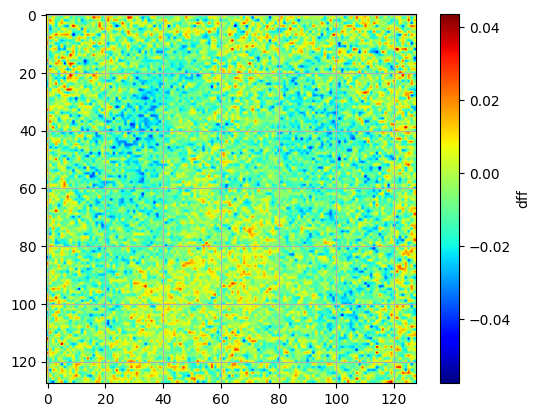

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:41,  3.10it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:38,  3.24it/s]

  2%|█▉                                                                                | 3/128 [00:00<00:37,  3.30it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:37,  3.29it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:37,  3.32it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:35,  3.41it/s]

  5%|████▍                                                                             | 7/128 [00:02<00:34,  3.48it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:36,  3.24it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:37,  3.21it/s]

  8%|██████▎                                                                          | 10/128 [00:03<00:35,  3.29it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:35,  3.31it/s]

  9%|███████▌                                                                         | 12/128 [00:03<00:33,  3.43it/s]

 10%|████████▏                                                                        | 13/128 [00:03<00:33,  3.45it/s]

 11%|████████▊                                                                        | 14/128 [00:04<00:35,  3.24it/s]

 12%|█████████▍                                                                       | 15/128 [00:04<00:34,  3.28it/s]

 12%|██████████▏                                                                      | 16/128 [00:04<00:34,  3.21it/s]

 13%|██████████▊                                                                      | 17/128 [00:05<00:34,  3.23it/s]

 14%|███████████▍                                                                     | 18/128 [00:05<00:32,  3.35it/s]

 15%|████████████                                                                     | 19/128 [00:05<00:31,  3.50it/s]

 16%|████████████▋                                                                    | 20/128 [00:05<00:30,  3.59it/s]

 16%|█████████████▎                                                                   | 21/128 [00:06<00:29,  3.62it/s]

 17%|█████████████▉                                                                   | 22/128 [00:06<00:29,  3.55it/s]

 18%|██████████████▌                                                                  | 23/128 [00:06<00:31,  3.30it/s]

 19%|███████████████▏                                                                 | 24/128 [00:07<00:32,  3.21it/s]

 20%|███████████████▊                                                                 | 25/128 [00:07<00:31,  3.27it/s]

 20%|████████████████▍                                                                | 26/128 [00:07<00:30,  3.30it/s]

 21%|█████████████████                                                                | 27/128 [00:08<00:31,  3.19it/s]

 22%|█████████████████▋                                                               | 28/128 [00:08<00:29,  3.34it/s]

 23%|██████████████████▎                                                              | 29/128 [00:08<00:28,  3.47it/s]

 23%|██████████████████▉                                                              | 30/128 [00:08<00:27,  3.54it/s]

 24%|███████████████████▌                                                             | 31/128 [00:09<00:27,  3.49it/s]

 25%|████████████████████▎                                                            | 32/128 [00:09<00:28,  3.32it/s]

 26%|████████████████████▉                                                            | 33/128 [00:09<00:27,  3.43it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:10<00:26,  3.49it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:10<00:25,  3.58it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:10<00:25,  3.66it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:10<00:26,  3.46it/s]

 30%|████████████████████████                                                         | 38/128 [00:11<00:26,  3.40it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:11<00:27,  3.29it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:11<00:26,  3.28it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:12<00:26,  3.23it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:12<00:26,  3.21it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:12<00:26,  3.24it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:13<00:26,  3.21it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:13<00:25,  3.31it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:13<00:24,  3.37it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:13<00:23,  3.48it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:14<00:25,  3.19it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:14<00:24,  3.24it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:14<00:24,  3.20it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:15<00:23,  3.28it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:15<00:22,  3.31it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:15<00:23,  3.26it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:16<00:22,  3.24it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:16<00:23,  3.16it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:16<00:23,  3.06it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:17<00:22,  3.11it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:17<00:22,  3.11it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:17<00:21,  3.20it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:18<00:21,  3.21it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:18<00:22,  3.02it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:18<00:22,  2.97it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:19<00:21,  2.96it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:19<00:22,  2.79it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:19<00:22,  2.86it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:20<00:21,  2.82it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:20<00:20,  2.92it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:20<00:21,  2.85it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:21<00:21,  2.79it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:21<00:20,  2.79it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:22<00:20,  2.77it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:22<00:20,  2.69it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:22<00:19,  2.82it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:23<00:19,  2.83it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:23<00:18,  2.94it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:23<00:17,  2.99it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:24<00:17,  2.91it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:24<00:16,  2.96it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:24<00:16,  3.01it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:25<00:16,  2.95it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:25<00:15,  3.01it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:25<00:15,  2.98it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:26<00:14,  3.06it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:26<00:13,  3.21it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:26<00:12,  3.32it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:26<00:12,  3.40it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:27<00:12,  3.21it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:27<00:12,  3.22it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:27<00:11,  3.31it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:28<00:11,  3.45it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:28<00:10,  3.41it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:28<00:10,  3.46it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:29<00:10,  3.23it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:29<00:10,  3.39it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:29<00:09,  3.48it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:29<00:09,  3.30it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:30<00:09,  3.26it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:30<00:09,  3.29it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:30<00:08,  3.33it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:31<00:08,  3.48it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:31<00:07,  3.46it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:31<00:07,  3.59it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:31<00:07,  3.42it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:32<00:07,  3.31it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:32<00:06,  3.33it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:32<00:06,  3.42it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:33<00:05,  3.54it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:33<00:05,  3.47it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:33<00:05,  3.46it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:34<00:05,  3.36it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:34<00:05,  3.33it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:34<00:05,  3.00it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:35<00:04,  3.16it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:35<00:04,  3.22it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:35<00:04,  3.23it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:35<00:03,  3.29it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:36<00:03,  3.32it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:36<00:02,  3.41it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:36<00:02,  3.30it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:37<00:02,  3.22it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:37<00:02,  3.29it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:37<00:01,  3.30it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:38<00:01,  3.32it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:38<00:01,  3.31it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:38<00:00,  3.27it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:38<00:00,  3.41it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:39<00:00,  3.38it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:39<00:00,  3.53it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:39<00:00,  3.24it/s]

frame number 200 plotted


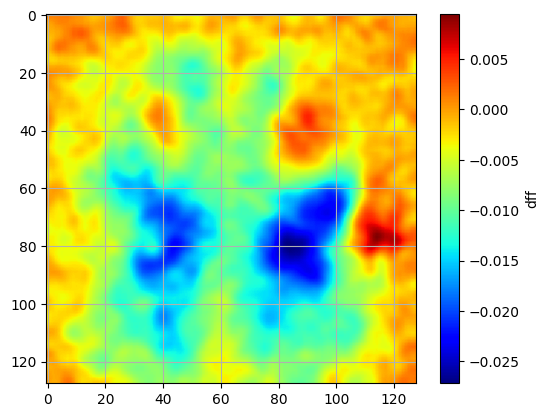

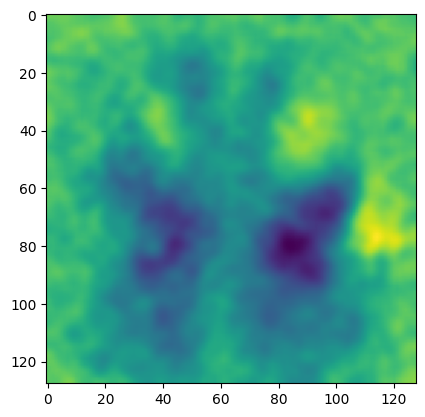

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 19


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 20
fail = 14
total trials = 34


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 27
fail = 20
total trials = 47


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 7
fail = 12
total trials = 19


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/34577 [00:00<?, ?it/s]

  8%|██████▏                                                                   | 2880/34577 [00:00<00:01, 28524.60it/s]

 17%|████████████▎                                                             | 5733/34577 [00:00<00:01, 24636.51it/s]

 24%|█████████████████▉                                                        | 8401/34577 [00:00<00:01, 25390.85it/s]

 32%|███████████████████████▏                                                 | 10965/34577 [00:00<00:00, 24306.21it/s]

 39%|████████████████████████████▎                                            | 13413/34577 [00:00<00:00, 24204.34it/s]

 46%|█████████████████████████████████▉                                       | 16053/34577 [00:00<00:00, 24837.54it/s]

 54%|███████████████████████████████████████▋                                 | 18786/34577 [00:00<00:00, 25621.07it/s]

 62%|█████████████████████████████████████████████                            | 21358/34577 [00:00<00:00, 22512.31it/s]

 68%|█████████████████████████████████████████████████▉                       | 23676/34577 [00:01<00:00, 21785.67it/s]

 76%|███████████████████████████████████████████████████████                  | 26109/34577 [00:01<00:00, 22431.91it/s]

 84%|████████████████████████████████████████████████████████████▉            | 28875/34577 [00:01<00:00, 23848.54it/s]

 91%|██████████████████████████████████████████████████████████████████       | 31297/34577 [00:01<00:00, 22410.82it/s]

 97%|███████████████████████████████████████████████████████████████████████  | 33671/34577 [00:01<00:00, 22718.98it/s]

100%|█████████████████████████████████████████████████████████████████████████| 34577/34577 [00:01<00:00, 23547.21it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 28581.29it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 18187.87it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")